In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

### python packages
import os
from os import path
import numpy as np
import glob as glob
from random import random
import pandas as pd

### torch packages
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data.sampler import Sampler

### sklearn packages
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.model_selection import KFold

import pickle
### remove these later (for notebook version only)
from tqdm import tqdm_notebook as tqdm

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300

In [2]:
tces=pd.DataFrame.from_csv('/home/hosborn/TESS/tces_with_starpars_fixed_ix.csv')

/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: FutureWarning: from_csv is deprecated. Please use read_csv(...) instead. Note that some of the default arguments are different, so please refer to the documentation for from_csv when changing your function calls
  """Entry point for launching an IPython kernel.


In [3]:
len(np.unique(tces.index.values))/len(tces.index.values)

1.0

In [4]:
np.all(np.load('real_nan_idlist4.npy')==np.load('real_nan_idlist3.npy')) and np.all(np.load('real_idlist4.npy')==np.load('real_idlist3.npy'))


True

In [3]:
mod2=pickle.load(open('binarymod.pickle','rb'))
mod3=pickle.load(open('3classmod.pickle','rb'))
mod4=pickle.load(open('4classmod.pickle','rb'))

mod2['real']=mod2['real'].rename(columns={c:'binary_'+c for c in mod2['real'].columns})
mod2['real_nan']=mod2['real_nan'].rename(columns={c:'binary_'+c for c in mod2['real_nan'].columns})

mod3['real']=mod3['real'].rename(columns={c:'3class_'+c for c in mod3['real'].columns})
mod3['real_nan']=mod3['real_nan'].rename(columns={c:'3class_'+c for c in mod3['real_nan'].columns})

mod4['real']=mod4['real'].rename(columns={c:'4class_'+c for c in mod4['real'].columns})
mod4['real_nan']=mod4['real_nan'].rename(columns={c:'4class_'+c for c in mod4['real_nan'].columns})

In [5]:
mod4['real_nan'].shape

(2197, 40)

In [4]:
tab=pd.concat([mod2['real'],mod3['real'],mod4['real']],axis=1)
tab['nans']=False

tab['pl_av_all']=np.average(tab.loc[:,['binary_av','3class_PL_av','4class_PL_av']].values,axis=1)
tab['pl_med_all']=np.nanmedian(tab.loc[:,['binary_med','3class_PL_med','4class_PL_med']].values,axis=1)
tab['rank']=np.argsort(tab['pl_av_all'])

tab2=pd.concat([mod2['real_nan'],mod3['real_nan'],mod4['real_nan']],axis=1)
tab2['nans']=True
tab2['pl_av_all']=np.average(tab2.loc[:,['binary_av','3class_PL_av','4class_PL_av']].values,axis=1)
tab2['pl_med_all']=np.nanmedian(tab2.loc[:,['binary_med','3class_PL_med','4class_PL_med']].values,axis=1)

tab2['rank']=np.argsort(tab2['pl_av_all'])+len(tab)

alltab=pd.concat([tab,tab2],axis=0)

In [5]:
df=alltab.join(tces)

In [6]:
rankeddf=df.iloc[df['rank'][::-1]]

In [9]:
rankeddf[['pl_av_all','pl_med_all','is_toi']]

,pl_av_all,pl_med_all,is_toi
000237332597_01_01,9.915168e-01,9.999999e-01,0.0
000265613590_01_01,9.811806e-01,1.000000e+00,0.0
000350743714_00_03,9.626163e-01,1.000000e+00,0.5
000166739520_00_02,9.363746e-01,1.000000e+00,0.5
000300903537_01_01,9.263641e-01,1.000000e+00,0.0
000235009317_01_01,9.253675e-01,1.000000e+00,0.0
000039018208_01_99,9.189056e-01,9.999984e-01,0.0
000308851582_01_04,9.165816e-01,9.999986e-01,0.0
000098658304_01_03,9.098229e-01,9.999883e-01,0.0
000220523550_01_99,9.083860e-01,9.999868e-01,0.0


In [11]:
rankeddf.columns[:50]

Index(['binary_0', 'binary_1', 'binary_2', 'binary_3', 'binary_4', 'binary_5',
       'binary_6', 'binary_7', 'binary_med', 'binary_av', '3class_EB_0',
       '3class_EB_1', '3class_EB_2', '3class_EB_3', '3class_EB_4',
       '3class_EB_5', '3class_EB_6', '3class_EB_7', '3class_PL_0',
       '3class_PL_1', '3class_PL_2', '3class_PL_3', '3class_PL_4',
       '3class_PL_5', '3class_PL_6', '3class_PL_7', '3class_UNK_0',
       '3class_UNK_1', '3class_UNK_2', '3class_UNK_3', '3class_UNK_4',
       '3class_UNK_5', '3class_UNK_6', '3class_UNK_7', '3class_UNK_med',
       '3class_UNK_av', '3class_PL_med', '3class_PL_av', '3class_EB_med',
       '3class_EB_av', '4class_BEB_0', '4class_BEB_1', '4class_BEB_2',
       '4class_BEB_3', '4class_BEB_4', '4class_BEB_5', '4class_BEB_6',
       '4class_BEB_7', '4class_EB_0', '4class_EB_1'],
      dtype='object')

In [91]:
pd.DataFrame.to_latex?

In [7]:
rankeddf['sectors']=np.array([s.replace('[','').replace(']','') for s in rankeddf['sectors'].values])
rankeddf['sectors']=np.array([s.replace('0 1 2','1 2 3') for s in rankeddf['sectors'].values])

In [8]:
rankeddf['TDEPTH']=np.round(rankeddf['TDEPTH'],-1).astype(int)

In [58]:
print(rankeddf.loc[(rankeddf['is_toi']>0.05)*(~rankeddf['nans'])*(rankeddf['pl_av_all']>0.5)][['TID','toi','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].iloc[:32].round(3).to_latex(index=None))
#Period & Epoch & Dur & Depth 
print(rankeddf.loc[(rankeddf['is_toi']>0.05)*(~rankeddf['nans'])*(rankeddf['pl_av_all']>0.5)][['TID','toi','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].shape)


\begin{tabular}{rrlrrrrrrrrrrrrr}
\toprule
       TID &     toi & sectors &  TPERIOD &    TEPOCH &   TDUR &  TDEPTH &  binary\_av &  3class\_UNK\_av &  3class\_PL\_av &  3class\_EB\_av &  4class\_UNK\_av &  4class\_PL\_av &  4class\_EB\_av &  4class\_BEB\_av &  pl\_av\_all \\
\midrule
 100100827 &  185.01 &       2 &    0.941 &  1354.458 &  2.153 &   10680 &      0.999 &            0.0 &           1.0 &           0.0 &            0.0 &           1.0 &           0.0 &            0.0 &      1.000 \\
 100100827 &  185.01 &       3 &    0.941 &  1386.467 &  2.153 &   10730 &      0.999 &            0.0 &           1.0 &           0.0 &            0.0 &           1.0 &           0.0 &            0.0 &      1.000 \\
 100100827 &  185.01 &   1 2 3 &    0.941 &  1354.458 &  2.153 &   10690 &      0.999 &            0.0 &           1.0 &           0.0 &            0.0 &           1.0 &           0.0 &            0.0 &      1.000 \\
  77031414 &  241.01 &       2 &    1.387 &  1355.196 &  2.290 

In [9]:
tois = pd.DataFrame.from_csv('/mnt/disks/tessdata/RealData/TOIs.csv')#,index_col=None)

/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: FutureWarning: from_csv is deprecated. Please use read_csv(...) instead. Note that some of the default arguments are different, so please refer to the documentation for from_csv when changing your function calls
  """Entry point for launching an IPython kernel.


In [10]:
tois=tois.rename(columns={'tic_id':'TID'})

In [11]:
rankeddf.loc[np.in1d(rankeddf.TID.values,tois.TID.values)*(rankeddf.is_toi==0.0),'is_toi']+=0.05

/home/hosborn/.local/lib/python3.5/site-packages/pandas/core/computation/expressions.py:180: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


In [68]:
rankeddf.to_csv('Ranked_TCE_Predictions_Real_Data.csv')


In [72]:
rankeddf.columns[80:]

Index(['nans', 'pl_av_all', 'pl_med_all', 'rank', 'MAXMES', 'MAXSES', 'TDEPTH',
       'TDUR', 'TEPOCH', 'TPERIOD', 'TSNR', 'n_det', 'rmsCdpp', 'sector',
       'sectors', 'is_toi', 'toi', 'toi_disp', 'TID', 'ID', 'MH', 'Teff',
       'Tmag', 'contratio', 'd', 'dec', 'gallat', 'gallong', 'logg', 'mass',
       'objType', 'pmDEC', 'pmRA', 'ra', 'rad', 'rho'],
      dtype='object')

In [73]:
cols4sh=['binary_med', 'binary_av','3class_UNK_med','3class_UNK_av', '3class_PL_med', '3class_PL_av', '3class_EB_med',
       '3class_EB_av', '4class_UNK_med', '4class_UNK_av','4class_PL_med', '4class_PL_av', '4class_EB_med', '4class_EB_av',
       '4class_BEB_med', '4class_BEB_av', 'nans', 'pl_av_all', 'pl_med_all','rank', 'MAXMES', 'MAXSES', 'TDEPTH', 'TDUR', 'TEPOCH', 'TPERIOD',
       'TSNR', 'n_det', 'rmsCdpp', 'sector', 'sectors', 'is_toi', 'toi','toi_disp', 'TID', 'ID','MH', 'Teff',
       'Tmag', 'contratio', 'd', 'dec', 'gallat', 'gallong', 'logg', 'mass','objType', 'pmDEC', 'pmRA', 'ra', 'rad', 'rho']


In [74]:
rankeddf[cols4sh].to_csv('Ranked_TCE_Predictions_Real_Data_sm.csv')

In [75]:
rankeddf[cols4sh]

,binary_med,binary_av,3class_UNK_med,3class_UNK_av,3class_PL_med,3class_PL_av,3class_EB_med,3class_EB_av,4class_UNK_med,4class_UNK_av,...,gallat,gallong,logg,mass,objType,pmDEC,pmRA,ra,rad,rho
000237332597_01_01,9.851022e-01,9.745565e-01,4.352740e-13,3.154343e-08,1.000000e+00,1.000000e+00,6.587987e-17,5.458495e-13,4.940330e-13,2.018404e-08,...,-51.957032,323.210808,4.24137,1.359900,STAR,0.517973,22.73350,346.828897,1.463130,0.434168
000265613590_01_01,9.745017e-01,9.435419e-01,2.662472e-13,1.034444e-08,1.000000e+00,1.000000e+00,6.333131e-20,5.258421e-17,3.947525e-12,2.277281e-08,...,-50.347868,338.681618,NaN,1.128390,STAR,-94.920000,148.48000,333.160562,1.523360,0.319192
000350743714_00_03,9.228935e-01,8.878619e-01,2.083746e-12,6.391005e-08,1.000000e+00,9.999999e-01,2.365381e-12,5.409514e-08,1.077151e-14,1.278420e-05,...,-29.987229,265.671963,3.96000,1.312030,STAR,-39.713100,3.85779,88.885933,1.874260,0.199276
000166739520_00_02,8.444984e-01,8.092058e-01,2.149306e-09,8.182875e-05,1.000000e+00,9.999182e-01,4.004375e-13,4.249446e-10,3.916765e-11,3.408923e-08,...,-60.529539,271.160782,4.35513,1.130000,STAR,24.626300,60.40450,36.775436,1.170000,0.705539
000300903537_01_01,7.876047e-01,7.819765e-01,1.268106e-08,3.359345e-08,1.000000e+00,9.971831e-01,1.465006e-12,2.816888e-03,6.054545e-11,6.077471e-05,...,-45.019575,18.155974,4.52234,0.773181,STAR,-30.561200,34.70310,321.546664,0.798331,1.519610
000235009317_01_01,7.831447e-01,7.920040e-01,1.108631e-08,1.281703e-06,1.000000e+00,9.841740e-01,3.131210e-10,1.582476e-02,1.431249e-13,5.837829e-10,...,-52.649068,318.453121,4.30770,1.100276,STAR,0.376924,6.36433,352.645890,1.219320,0.606951
000039018208_01_99,8.559543e-01,8.006326e-01,7.935386e-08,4.056599e-03,9.999984e-01,9.576644e-01,6.623812e-07,3.827896e-02,5.194809e-09,5.470694e-04,...,-50.965048,303.426025,4.03000,1.121620,STAR,3.228280,-2.82711,12.089551,1.535990,0.309514
000308851582_01_04,8.437847e-01,7.694902e-01,1.301204e-06,1.754949e-03,9.999986e-01,9.982343e-01,1.383409e-07,1.077474e-05,1.266551e-09,1.632504e-07,...,-16.022552,277.254287,4.34009,1.043514,STAR,62.670000,-43.72000,122.586205,1.143980,0.697019
000098658304_01_03,8.726509e-01,8.407381e-01,4.018730e-07,2.225577e-04,9.999883e-01,9.997712e-01,6.831715e-10,6.225150e-06,4.962323e-09,1.137660e-03,...,-84.353581,83.025712,4.53182,0.752650,STAR,18.430000,105.75000,8.935010,0.779112,1.591450
000220523550_01_99,7.775090e-01,7.298495e-01,7.960397e-06,2.011796e-03,9.999868e-01,9.979869e-01,3.538911e-13,1.332662e-06,8.363574e-10,2.678439e-03,...,-47.572017,284.994090,4.36000,1.219090,STAR,5.749090,7.69391,42.562588,1.480320,0.375811


In [41]:
print(rankeddf.loc[(rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])][['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].iloc[:32].round(3).to_latex(index=None))
#Period & Epoch & Dur & Depth 
print(rankeddf.loc[(rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])][['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].shape)


\begin{tabular}{rlrrrrrrrrrrrrr}
\toprule
       TID & sectors &  TPERIOD &    TEPOCH &   TDUR &  TDEPTH &  binary\_av &  3class\_UNK\_av &  3class\_PL\_av &  3class\_EB\_av &  4class\_UNK\_av &  4class\_PL\_av &  4class\_EB\_av &  4class\_BEB\_av &  pl\_av\_all \\
\midrule
  92352621 &       1 &    3.950 &  1328.299 &  4.560 &   14230 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.999 \\
 139256217 &       1 &    2.199 &  1325.350 &  3.821 &   18410 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.999 \\
 259470701 &       4 &    2.543 &  1412.514 &  3.845 &   17670 &      0.995 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.998 \\
 231275247 &       2 &    4.008 &  1354.114 &  4.995 &   21100 &      0.995 &          0.000 &         1

In [55]:
print(rankeddf.loc[(rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']>0.05)*(~rankeddf['nans'])][['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].iloc[:32].round(3).to_latex(index=None))
#Period & Epoch & Dur & Depth 
print(rankeddf.loc[(rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']>0.05)*(~rankeddf['nans'])][['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].shape)


\begin{tabular}{rlrrrrrrrrrrrrr}
\toprule
       TID & sectors &  TPERIOD &    TEPOCH &   TDUR &  TDEPTH &  binary\_av &  3class\_UNK\_av &  3class\_PL\_av &  3class\_EB\_av &  4class\_UNK\_av &  4class\_PL\_av &  4class\_EB\_av &  4class\_BEB\_av &  pl\_av\_all \\
\midrule
 100100827 &       2 &    0.941 &  1354.458 &  2.153 &   10680 &      0.999 &            0.0 &           1.0 &           0.0 &            0.0 &           1.0 &           0.0 &            0.0 &      1.000 \\
 100100827 &       3 &    0.941 &  1386.467 &  2.153 &   10730 &      0.999 &            0.0 &           1.0 &           0.0 &            0.0 &           1.0 &           0.0 &            0.0 &      1.000 \\
 100100827 &   1 2 3 &    0.941 &  1354.458 &  2.153 &   10690 &      0.999 &            0.0 &           1.0 &           0.0 &            0.0 &           1.0 &           0.0 &            0.0 &      1.000 \\
  77031414 &       2 &    1.387 &  1355.196 &  2.290 &   14260 &      0.998 &            0.0 &          

In [593]:
rankeddf.loc[rankeddf['toi']==178.02].iloc[1][-50:]

4class_UNK_2         0.999793
4class_UNK_3                1
4class_UNK_4         0.783873
4class_UNK_5                1
4class_UNK_6         0.999993
4class_UNK_7                1
4class_UNK_med       0.999893
4class_UNK_av        0.864133
4class_PL_med     0.000106962
4class_PL_av         0.135867
4class_EB_med     3.71307e-14
4class_EB_av      1.74978e-11
4class_BEB_med    9.31421e-10
4class_BEB_av     2.03528e-08
nans                    False
pl_av_all            0.078385
pl_med_all        0.000106962
rank                     3419
MAXMES                7.67955
MAXSES                6.51132
TDEPTH                   1130
TDUR                  2.52181
TEPOCH                1362.95
TPERIOD               9.95594
TSNR                  7.63887
n_det                       2
rmsCdpp                   NaN
sector                      2
sectors                     2
is_toi                    0.5
toi                    178.02
toi_disp                   PC
TID                 251848941
ID        

In [ ]:
epoch=1354.55/period=10.3543 = 82.6%/98.9% (average/median)
epoch=1362.95/period=9.95594 = 7.8%/0.01% (average/median)

In [577]:
print(rankeddf.loc[(rankeddf['3class_UNK_av']>0.5)*(rankeddf['is_toi']>0.2)*(~rankeddf['nans'])][['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].shape)


(95, 15)


In [469]:
n=20

In [548]:
len(confpls.TID.values)

93

                    TDEPTH  toi      TDUR   TPERIOD  pl_av_all       rad  \
000207109417_00_03     490  0.0  0.514213  0.291789   0.999501  0.728582   

                    Tmag         ra        dec  
000207109417_00_03  9.89  42.373398 -54.637497  


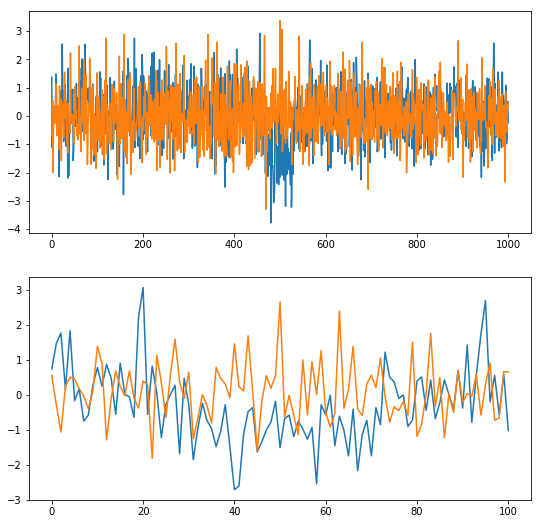

In [559]:
confpls=rankeddf.loc[(rankeddf['pl_av_all']>0.95)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])]
print(confpls.loc[np.argsort(confpls.Tmag)==n][['TDEPTH','toi','TDUR','TPERIOD','pl_av_all','rad','Tmag','ra','dec']])
plt.figure(figsize=(9,9))
plt.subplot(211)
tid=confpls.loc[np.argsort(confpls.Tmag)==n].iloc[0].name
plt.plot(np.load('../Processed_RealDat_2/'+tid+'_glob.npy'))
plt.subplot(212)
plt.plot(np.load('../Processed_RealDat_2/'+tid+'_loc.npy'))
n+=1

In [63]:
rankeddf.loc[(rankeddf['pl_av_all']>0.90)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])*(~rankeddf['TDEPTH']<5000)].shape

(57, 116)

In [29]:
import requests

plcands=rankeddf.loc[(rankeddf['pl_av_all']>0.9)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])*(~rankeddf['TDEPTH']<5000)]

LC_locs={1:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018206045859-s0001-TIDTIDTIDTID-0120-s_lc.fits",
         2:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018234235059-s0002-TIDTIDTIDTID-0121-s_lc.fits",
         3:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018263035959-s0003-TIDTIDTIDTID-0123-s_lc.fits",
         4:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018292075959-s0004-TIDTIDTIDTID-0124-s_lc.fits"}

plcands['allsects_av']=np.tile('',len(plcands))
plcands['allsects_intce']=np.tile('',len(plcands))
for row in plcands.iterrows():
    for sect in LC_locs:
        request = requests.get(LC_locs[sect].replace('TIDTIDTIDTID',str(int(row[1]['TID'])).zfill(16)))
        if request.status_code == 200:
            plcands.loc[row[0],'allsects_av']+=str(sect)
        allsects=' '.join(list(tces.loc[(tces.TID==row[1]['TID'])]['sectors'].values))
        if str(sect) in allsects:
            plcands.loc[row[0],'allsects_intce']+=str(sect)
        #*(sect in tces.TID==row[1]['TID'])]
    

/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.
/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()
/home/hosborn/.local/lib/python3.5/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

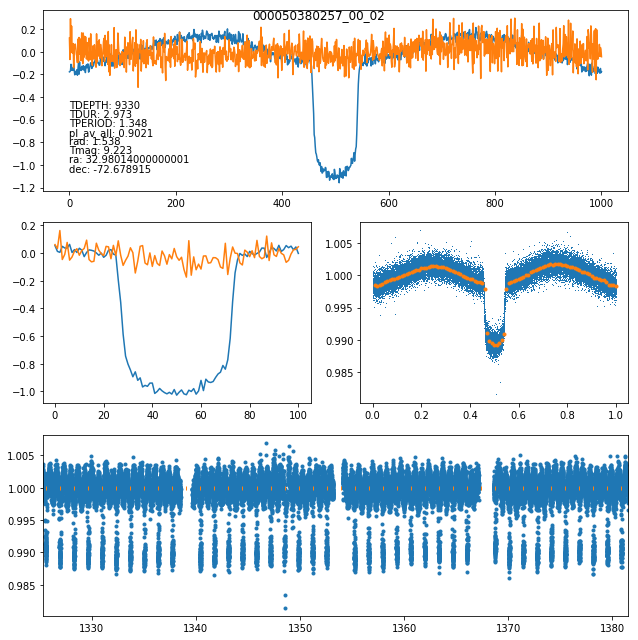

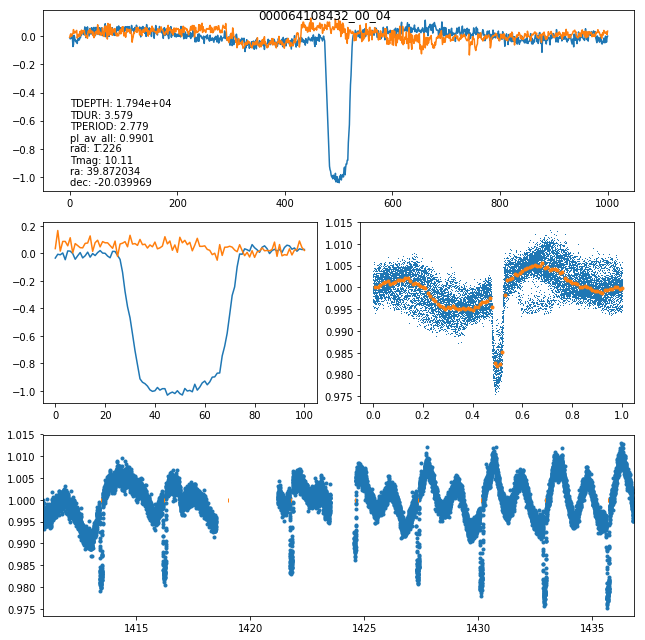

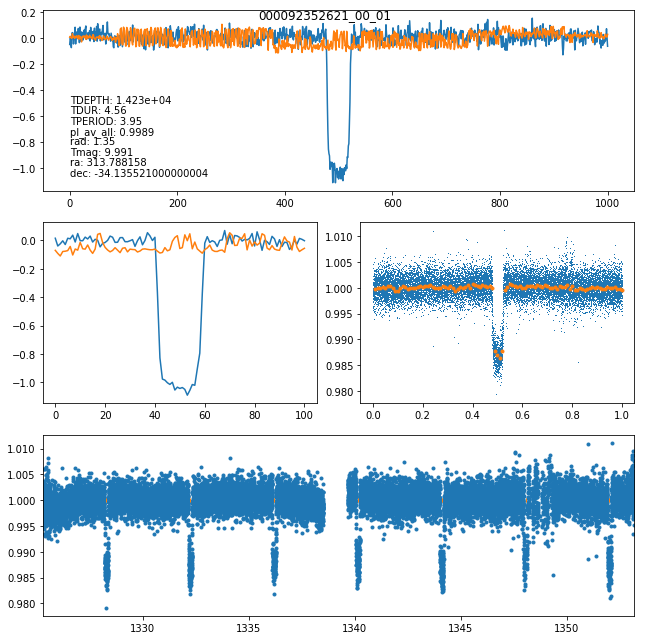

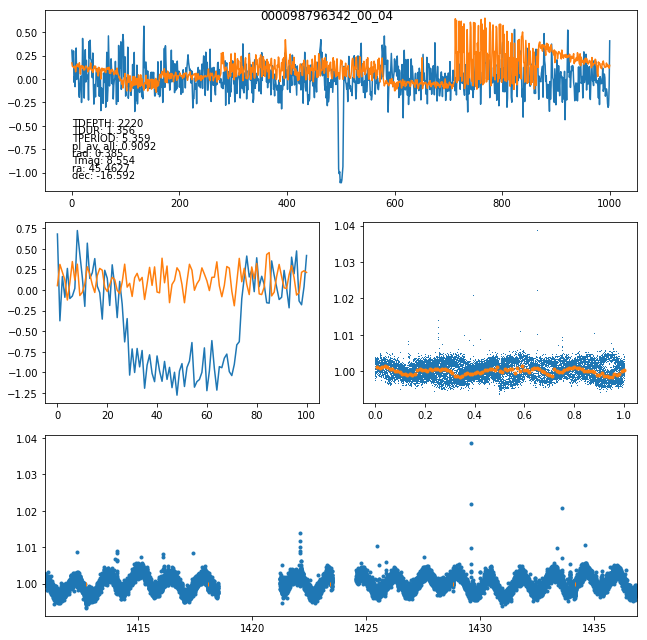

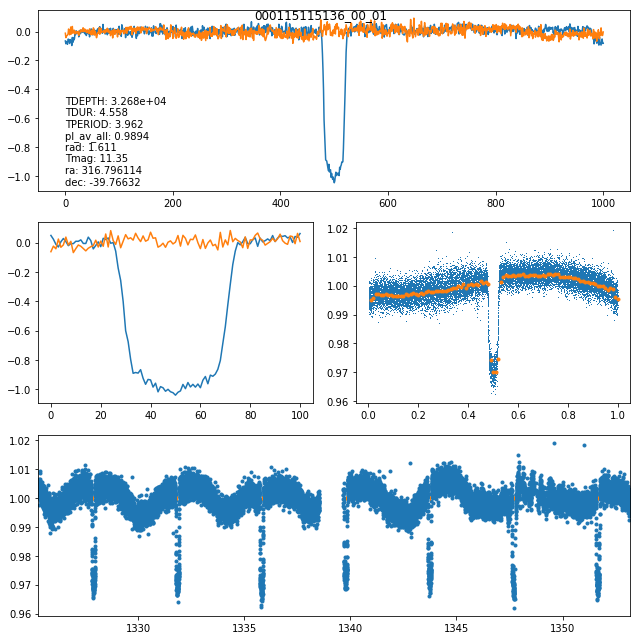

...

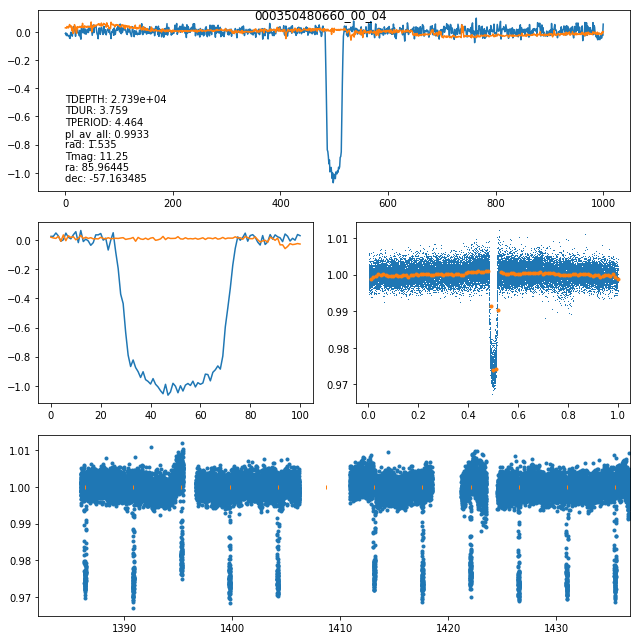

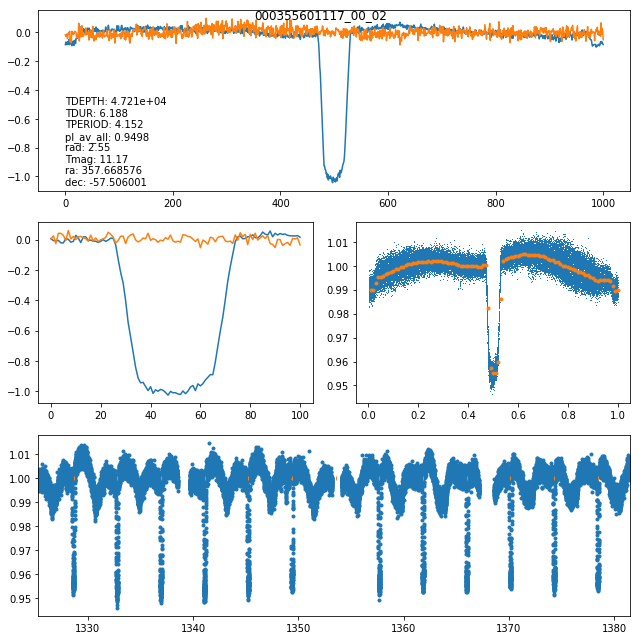

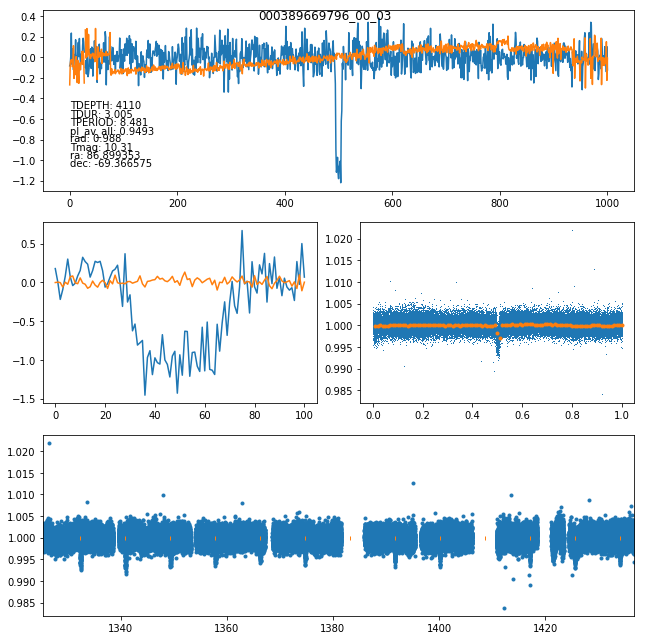

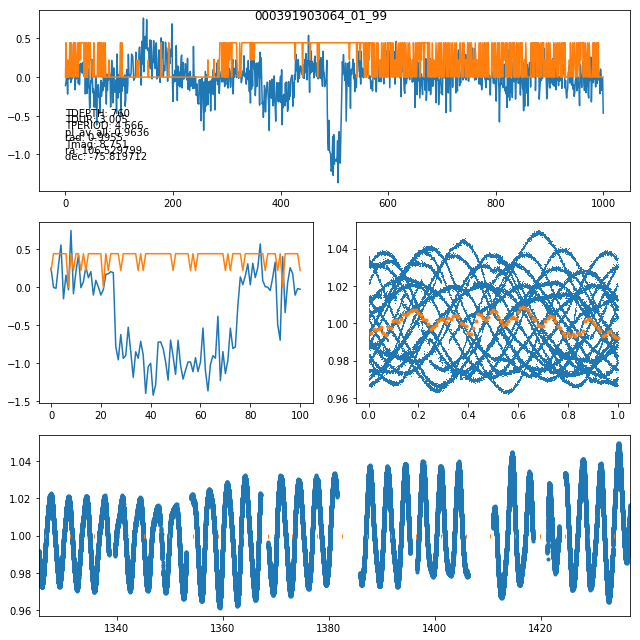

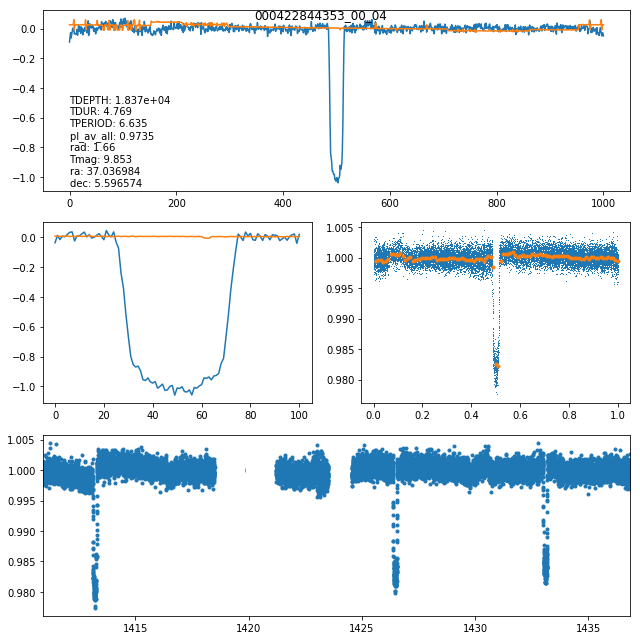

In [79]:
from astropy.io import fits
unq,idx=np.unique(plcands.TID.values,return_index=True)
for plcand in plcands.iloc[idx].iterrows():
    #
    plt.figure(figsize=(9,9))
    plt.suptitle(plcand[0])
    plt.subplot(311)
    for n,qual in enumerate(['TDEPTH','TDUR','TPERIOD','pl_av_all','rad','Tmag']):
        plt.text(0,-0.5-0.08*n,qual+": "+"{0:.4g}".format(plcands.loc[plcand[0]][qual]))
    plt.text(0,-0.5-0.08*(n+1),"ra: "+str(plcands.loc[plcand[0]]['ra']))
    plt.text(0,-0.5-0.08*(n+2),"dec: "+str(plcands.loc[plcand[0]]['dec']))
    plt.plot(np.load('../Processed_RealDat_2/'+plcand[0]+'_glob.npy'))
    plt.subplot(323)
    plt.plot(np.load('../Processed_RealDat_2/'+plcand[0]+'_loc.npy'))
    plt.subplot(313)
    lc=[]
    for sect in plcands.loc[plcand[0]]['allsects_av']:
        try:
            f=fits.open(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(plcand[1]['TID'])).zfill(16)))
            lc+=[np.column_stack((f[1].data['TIME'],f[1].data['PDCSAP_FLUX']/np.nanmedian(f[1].data['PDCSAP_FLUX'])))]
        except:
            print(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(plcand[1]['TID'])).zfill(16)),' - cant access')
    lc=np.vstack(lc)
    plt.plot(lc[:,0],lc[:,1],'.')
    plt.plot(np.arange(plcand[1]['TEPOCH']-200*plcand[1]['TPERIOD'],
                     plcand[1]['TEPOCH']+200.0005*plcand[1]['TPERIOD'],
                     plcand[1]['TPERIOD']),np.tile(1.0,401),
             '|',markersize=3.5)
    plt.xlim(lc[0,0],lc[-1,0])
    
    plt.subplot(324)
    lc[:,0]-=(plcand[1]['TEPOCH']+plcand[1]['TPERIOD']*0.5)
    lc[:,0]=(lc[:,0]%plcand[1]['TPERIOD'])/plcand[1]['TPERIOD']
    plt.plot(lc[:,0],lc[:,1],',')
    digs=np.digitize(lc[:,0],np.arange(0,1.0,0.01))
    flc=[np.nanmedian(lc[digs==bin,1]) for bin in np.arange(101)]
    plt.plot(np.arange(0,1.01,0.01),flc,'.')
    
    plt.tight_layout()
    plt.savefig("PredictedPlanets/"+plcand[0]+'.png')
    #n+=1
    #[['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all','allsects_av','allsects_intce']]

/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


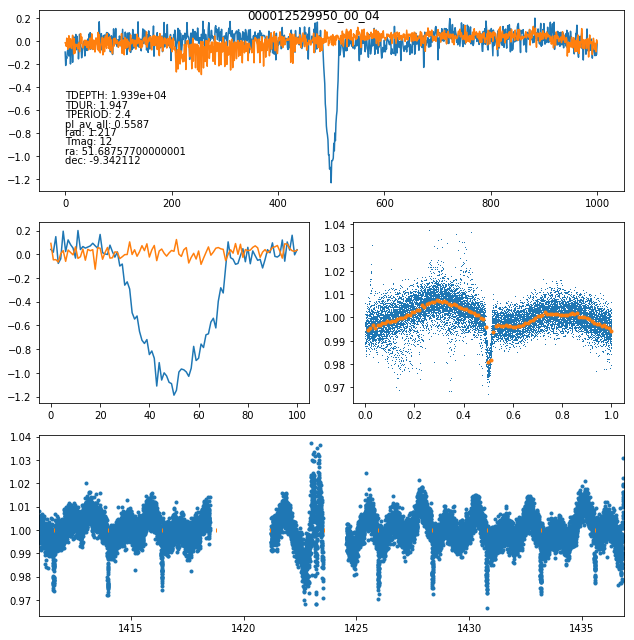

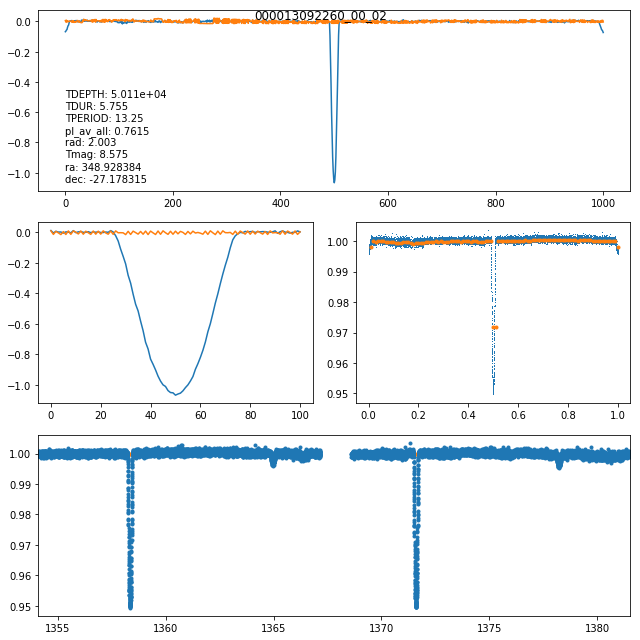

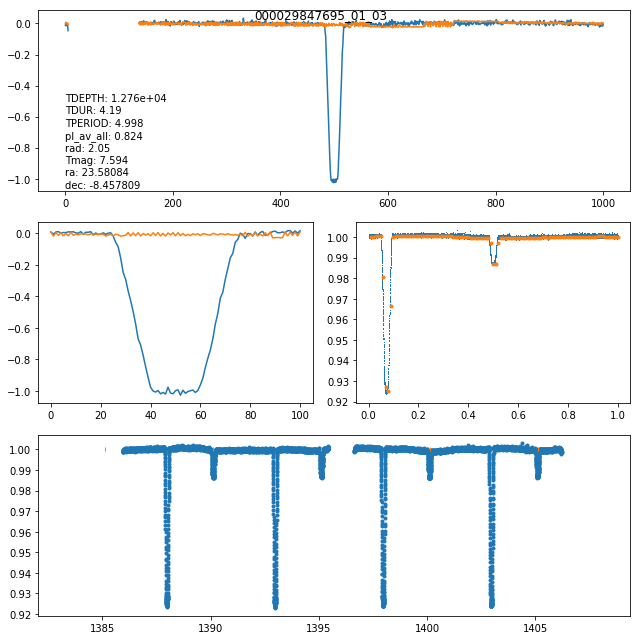

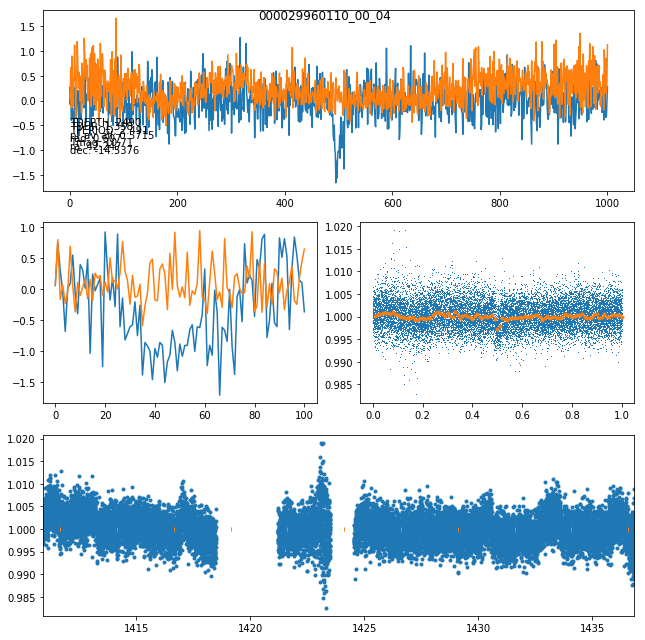

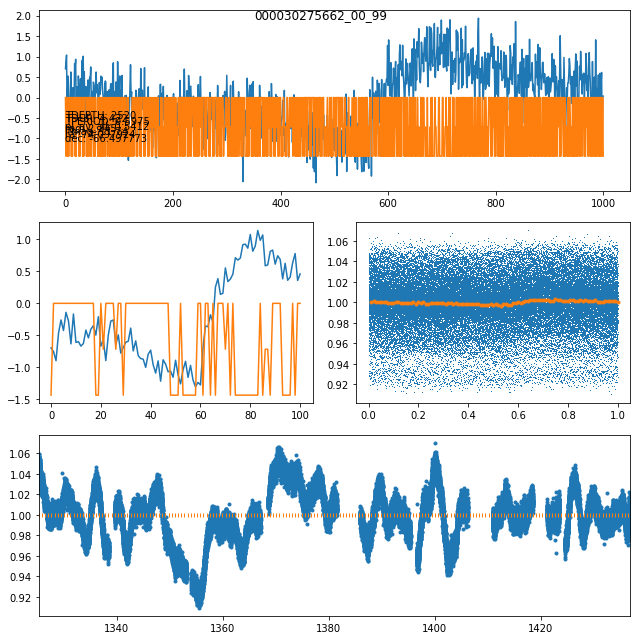

...

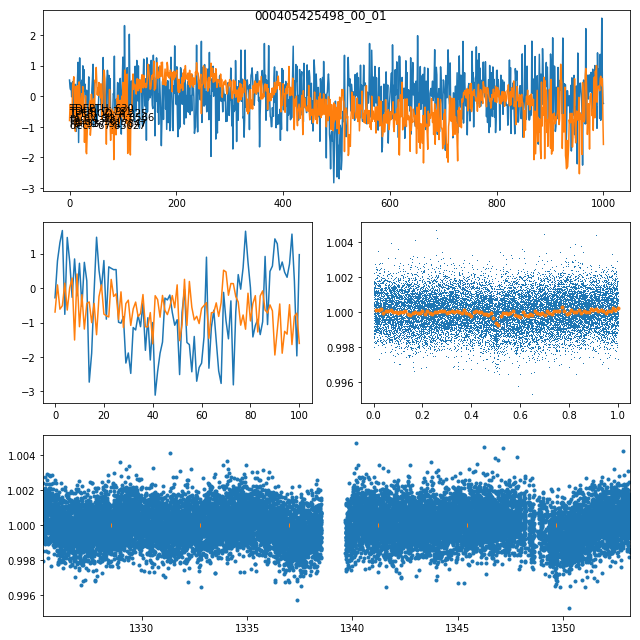

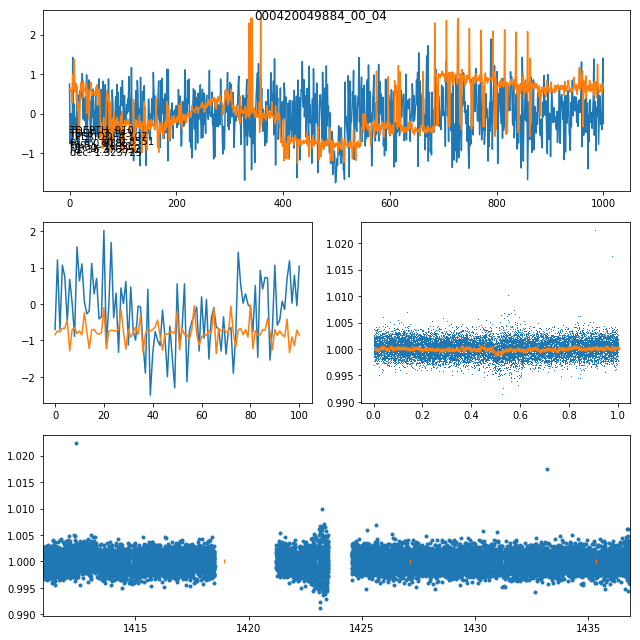

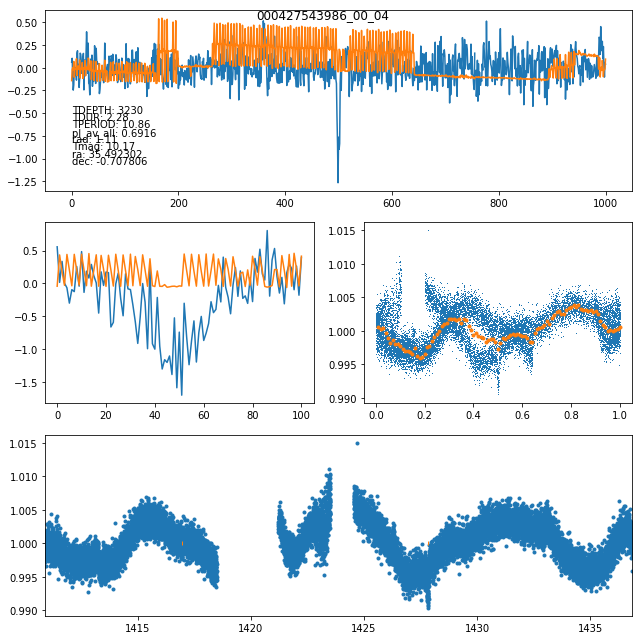

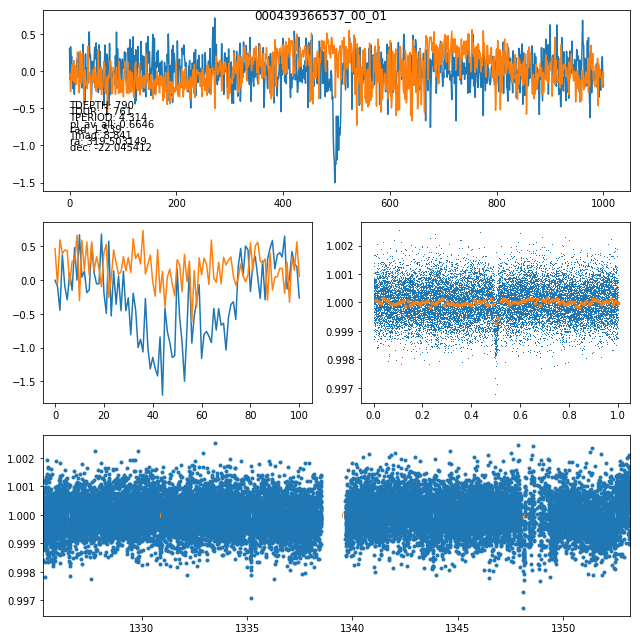

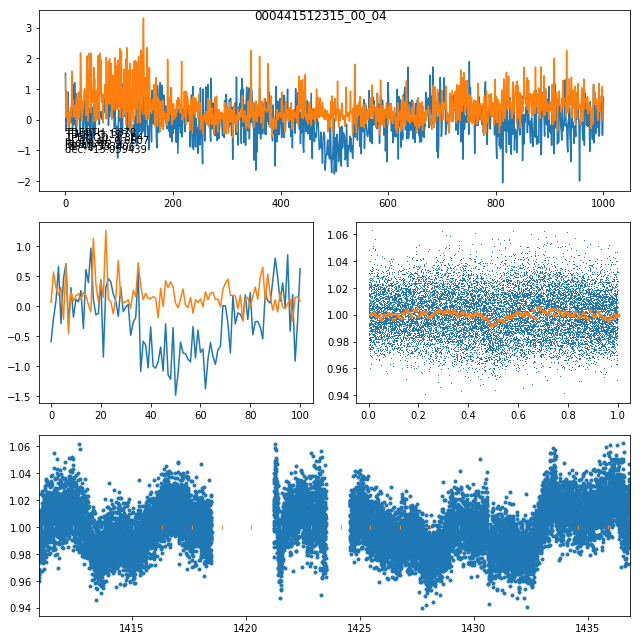

In [78]:
plcands2=rankeddf.loc[(rankeddf['pl_av_all']>0.5)*(rankeddf['pl_av_all']<0.9)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])*(~rankeddf['TDEPTH']<5000)]
plcands2['allsects_av']=np.tile('',len(plcands2))
plcands2['allsects_intce']=np.tile('',len(plcands2))
for row in plcands2.iterrows():
    for sect in LC_locs:
        request = requests.get(LC_locs[sect].replace('TIDTIDTIDTID',str(int(row[1]['TID'])).zfill(16)))
        if request.status_code == 200:
            plcands2.loc[row[0],'allsects_av']+=str(sect)
        allsects=' '.join(list(tces.loc[(tces.TID==row[1]['TID'])]['sectors'].values))
        if str(sect) in allsects:
            plcands2.loc[row[0],'allsects_intce']+=str(sect)
        #*(sect in tces.TID==row[1]['TID'])]

        
from astropy.io import fits
unq,idx=np.unique(plcands2.TID.values,return_index=True)
for plcand in plcands2.iloc[idx].iterrows():
    #
    plt.figure(figsize=(9,9))
    plt.suptitle(plcand[0])
    plt.subplot(311)
    for n,qual in enumerate(['TDEPTH','TDUR','TPERIOD','pl_av_all','rad','Tmag']):
        plt.text(0,-0.5-0.08*n,qual+": "+"{0:.4g}".format(plcand[1][qual]))
    plt.text(0,-0.5-0.08*(n+1),"ra: "+str(plcand[1]['ra']))
    plt.text(0,-0.5-0.08*(n+2),"dec: "+str(plcand[1]['dec']))
    plt.plot(np.load('../Processed_RealDat_2/'+plcand[0]+'_glob.npy'))
    plt.subplot(323)
    plt.plot(np.load('../Processed_RealDat_2/'+plcand[0]+'_loc.npy'))
    plt.subplot(313)
    lc=[]
    for sect in plcand[1]['allsects_av']:
        try:
            f=fits.open(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(plcand[1]['TID'])).zfill(16)))
            lc+=[np.column_stack((f[1].data['TIME'],f[1].data['PDCSAP_FLUX']/np.nanmedian(f[1].data['PDCSAP_FLUX'])))]
        except:
            print(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(plcand[1]['TID'])).zfill(16)),' - cant access')
    lc=np.vstack(lc)
    plt.plot(lc[:,0],lc[:,1],'.')
    plt.plot(np.arange(plcand[1]['TEPOCH']-200*plcand[1]['TPERIOD'],
                     plcand[1]['TEPOCH']+200.0005*plcand[1]['TPERIOD'],
                     plcand[1]['TPERIOD']),np.tile(1.0,401),
             '|',markersize=3.5)
    plt.xlim(lc[0,0],lc[-1,0])
    
    plt.subplot(324)
    lc[:,0]-=(plcand[1]['TEPOCH']+plcand[1]['TPERIOD']*0.5)
    lc[:,0]=(lc[:,0]%plcand[1]['TPERIOD'])/plcand[1]['TPERIOD']
    plt.plot(lc[:,0],lc[:,1],',')
    digs=np.digitize(lc[:,0],np.arange(0,1.0,0.01))
    flc=[np.nanmedian(lc[digs==bin,1]) for bin in np.arange(101)]
    plt.plot(np.arange(0,1.01,0.01),flc,'.')
    
    plt.tight_layout()
    plt.savefig("PredictedPlanets/"+plcand[0]+'.png')
    #n+=1
    #[['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all','allsects_av','allsects_intce']]

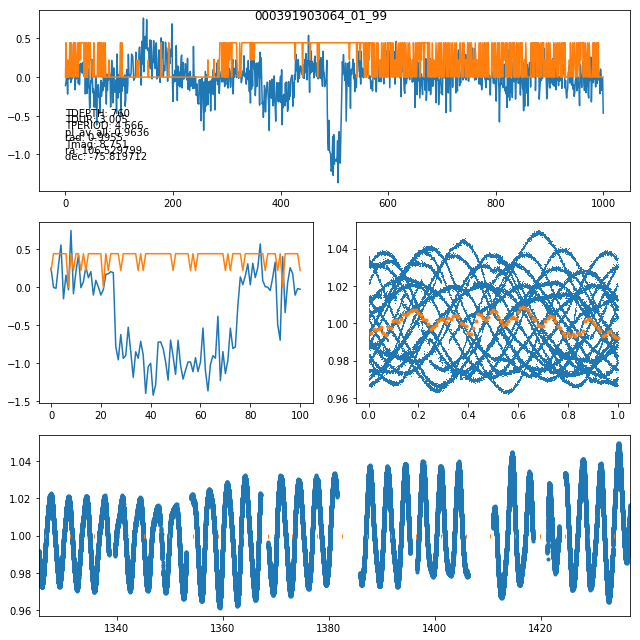

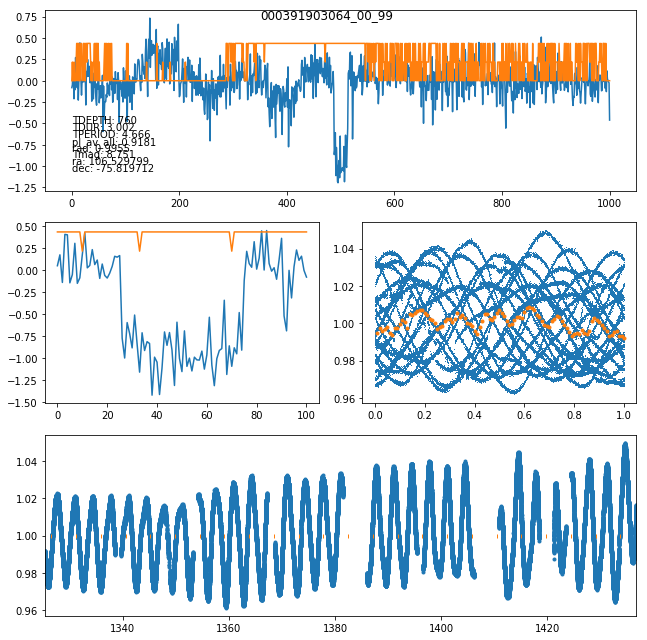

In [79]:
for plcand in rankeddf.loc[rankeddf.TID==391903064].iterrows():
    plt.figure(figsize=(9,9))
    plt.suptitle(plcand[0])
    plt.subplot(311)
    for n,qual in enumerate(['TDEPTH','TDUR','TPERIOD','pl_av_all','rad','Tmag']):
        plt.text(0,-0.5-0.08*n,qual+": "+"{0:.4g}".format(plcand[1][qual]))
    plt.text(0,-0.5-0.08*(n+1),"ra: "+str(plcand[1]['ra']))
    plt.text(0,-0.5-0.08*(n+2),"dec: "+str(plcand[1]['dec']))
    plt.plot(np.load('../Processed_RealDat_2/'+plcand[0]+'_glob.npy'))
    plt.subplot(323)
    plt.plot(np.load('../Processed_RealDat_2/'+plcand[0]+'_loc.npy'))
    plt.subplot(313)
    lc=[]
    for sect in [1,2,3,4]:
        try:
            f=fits.open(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(plcand[1]['TID'])).zfill(16)))
            lc+=[np.column_stack((f[1].data['TIME'],f[1].data['PDCSAP_FLUX']/np.nanmedian(f[1].data['PDCSAP_FLUX'])))]
        except:
            print(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(plcand[1]['TID'])).zfill(16)),' - cant access')
    lc=np.vstack(lc)
    plt.plot(lc[:,0],lc[:,1],'.')
    plt.plot(np.arange(plcand[1]['TEPOCH']-200*plcand[1]['TPERIOD'],
                     plcand[1]['TEPOCH']+200.0005*plcand[1]['TPERIOD'],
                     plcand[1]['TPERIOD']),np.tile(1.0,401),
             '|',markersize=3.5)
    plt.xlim(lc[0,0],lc[-1,0])
    
    plt.subplot(324)
    lc[:,0]-=(plcand[1]['TEPOCH']+plcand[1]['TPERIOD']*0.5)
    lc[:,0]=(lc[:,0]%plcand[1]['TPERIOD'])/plcand[1]['TPERIOD']
    plt.plot(lc[:,0],lc[:,1],',')
    digs=np.digitize(lc[:,0],np.arange(0,1.0,0.01))
    flc=[np.nanmedian(lc[digs==bin,1]) for bin in np.arange(101)]
    plt.plot(np.arange(0,1.01,0.01),flc,'.')
    
    plt.tight_layout()
    plt.savefig("PredictedPlanets/"+plcand[0]+'.png')


In [85]:
sns.set_palette('GnBu_d',12)

,binary_0,binary_1,binary_2,binary_3,binary_4,binary_5,binary_6,binary_7,binary_med,binary_av,...,logg,mass,objType,pmDEC,pmRA,ra,rad,rho,allsects_av,allsects_intce
000391903064_01_99,0.725373,0.904748,0.948218,0.954729,0.833680,0.973324,0.960883,0.910115,0.929166,0.901384,...,4.54516,1.26722,STAR,38.6831,-5.55008,106.529799,0.995541,1.28432,1234,12
000391903064_00_99,0.621531,0.899730,0.940406,0.952459,0.727692,0.980326,0.970486,0.924114,0.932260,0.877093,...,4.54516,1.26722,STAR,38.6831,-5.55008,106.529799,0.995541,1.28432,1234,12


In [112]:
rankeddf

,binary_0,binary_1,binary_2,binary_3,binary_4,binary_5,binary_6,binary_7,binary_med,binary_av,...,gallat,gallong,logg,mass,objType,pmDEC,pmRA,ra,rad,rho
000434097226_02_02,6.405269e-03,2.710240e-02,2.644361e-03,2.220343e-02,1.915291e-06,2.010730e-03,1.870479e-03,7.651033e-05,2.327546e-03,7.789387e-03,...,-65.583462,67.522232,4.01356,1.066960,STAR,-80.84360,-14.539100,352.507762,1.684640,0.223165
000300010961_05_99,7.088574e-16,4.589622e-19,0.000000e+00,4.428746e-13,0.000000e+00,0.000000e+00,5.227442e-32,0.000000e+00,2.613721e-32,5.544798e-14,...,-23.501356,278.817232,NaN,NaN,STAR,3.10000,-4.100000,106.945624,NaN,NaN
000214873946_01_01,2.295164e-03,8.814500e-03,3.757619e-03,2.417995e-03,3.968606e-04,2.491418e-03,8.121016e-04,7.863690e-03,2.454706e-03,3.606169e-03,...,-62.003786,4.376797,4.42517,0.931576,STAR,-19.18000,83.380000,341.760503,0.980030,0.989693
000281498280_01_02,5.621063e-03,6.508928e-06,2.064525e-05,1.490127e-05,2.487327e-08,9.067848e-05,2.638589e-07,2.866805e-04,1.777326e-05,7.550957e-04,...,-61.261222,310.600339,4.99696,0.239000,STAR,14.32000,241.730000,6.358900,0.257000,14.079900
000260654645_00_01,8.606681e-14,2.102047e-09,1.648683e-16,5.221643e-13,0.000000e+00,0.000000e+00,1.816327e-24,9.533141e-11,4.311584e-14,2.747483e-10,...,-25.118289,267.023774,4.18469,1.472903,STAR,6.05120,-1.026830,98.188448,1.625390,0.343004
000441354271_00_01,1.754199e-04,1.171151e-03,3.782535e-02,9.376468e-04,4.076116e-04,3.324949e-03,2.178508e-03,6.682656e-05,1.054399e-03,5.760932e-03,...,-35.483481,11.365771,0.98000,0.781352,STAR,-26.06200,14.903200,309.514658,9.624640,1.439900
000262609754_02_99,8.173054e-09,1.365049e-10,4.457391e-31,3.499454e-12,4.326586e-15,8.464941e-37,0.000000e+00,8.052648e-25,2.163293e-15,1.039133e-09,...,-17.812161,274.362028,4.60827,0.854360,STAR,31.28000,-39.470000,116.324967,0.752785,2.002760
000300010961_00_99,9.980327e-14,6.203742e-09,0.000000e+00,7.777807e-13,1.093501e-10,4.621080e-22,2.696263e-23,2.373479e-23,4.990164e-14,7.892462e-10,...,-23.501356,278.817232,NaN,NaN,STAR,3.10000,-4.100000,106.945624,NaN,NaN
000214913715_00_01,3.164643e-03,8.506459e-04,1.107259e-04,7.150780e-04,3.451927e-05,1.260409e-04,2.151579e-05,2.903115e-02,4.205595e-04,4.256790e-03,...,-62.002425,3.444851,4.10326,0.979747,STAR,-112.90200,91.366800,341.874270,1.455940,0.317456
000260654645_00_99,1.532678e-06,1.478746e-21,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.915847e-07,...,-25.118289,267.023774,4.18469,1.472903,STAR,6.05120,-1.026830,98.188448,1.625390,0.343004


In [77]:
toplot=rankeddf.loc[['000300579472_00_01','000141712167_01_99','000319289826_00_01','000300932479_00_04','000389669796_00_03','000177036769_00_04','000219406747_00_03','000044737596_00_04','000177170266_00_04','000207109417_00_03','000391903064_00_99']]


toplot['plrad']=np.sqrt(toplot['TDEPTH']*1e-6)*toplot['rad']*110

toplot[['TDEPTH','toi','TDUR','TPERIOD','plrad','pl_av_all','rad','Tmag','ra','dec']]


,TDEPTH,toi,TDUR,TPERIOD,plrad,pl_av_all,rad,Tmag,ra,dec
000300579472_00_01,700,0.0,3.613507,12.759807,2.558055,0.576277,0.878958,8.940,321.107280,-29.247365
000141712167_01_99,210,0.0,0.592071,0.866062,1.868420,0.914979,1.172120,9.390,90.881578,-72.764519
000319289826_00_01,1310,0.0,2.003991,2.715936,3.827230,0.929072,0.961294,10.664,71.731969,-80.517845
000300932479_00_04,2120,0.0,2.960066,4.814922,6.420622,0.940487,1.267700,10.633,117.659705,-69.860229
000389669796_00_03,4110,0.0,3.004929,8.481257,6.967171,0.949309,0.987968,10.310,86.899353,-69.366575
000177036769_00_04,1410,0.0,2.562787,4.819050,6.913790,0.780202,1.673840,9.846,102.578024,-66.976430
000219406747_00_03,530,0.0,2.998234,4.171061,9.864749,0.676036,3.895430,7.904,78.810233,-53.093029
000044737596_00_04,26230,0.0,1.950640,2.788476,NaN,0.511224,NaN,13.787,60.949323,-25.408914
000177170266_00_04,5940,0.0,3.192986,4.817378,11.118620,0.617593,1.311490,10.547,104.833505,-69.041051
000207109417_00_03,490,0.0,0.514213,0.291789,1.774064,0.916568,0.728582,9.890,42.373398,-54.637497


In [99]:
rankeddf.loc[(rankeddf.TPERIOD>4.75)*(rankeddf.TPERIOD<4.85)*(rankeddf.sector==4)][['sectors','ra','dec','TDEPTH','TPERIOD','Tmag','TEPOCH']]


,sectors,ra,dec,TDEPTH,TPERIOD,Tmag,TEPOCH
000382188882_00_04,4,81.352974,-55.019917,5270,4.800075,10.61500,1411.762521
000300932479_00_04,4,117.659705,-69.860229,2120,4.814922,10.63300,1414.086568
000300871545_00_04,4,117.657590,-70.533607,23430,4.816914,10.02500,1414.084113
000177036769_00_04,4,102.578024,-66.976430,1410,4.819050,9.84600,1414.082817
000391899797_00_04,4,115.657390,-68.111017,4260,4.815298,11.47300,1414.090852
000177170266_00_04,4,104.833505,-69.041051,5940,4.817378,10.54700,1414.082696
000120896927_00_04,4,36.868245,-27.635184,410,4.755833,8.26509,1411.463494
000306735585_00_04,4,120.539314,-66.306129,5230,4.816764,12.04700,1414.081670
000300808454_00_04,4,116.562711,-66.986412,4430,4.814856,12.17700,1414.092323


https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018234235059-s0002-0000000265613590-0121-s_lc.fits  - cant access
https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018263035959-s0003-0000000265613590-0123-s_lc.fits  - cant access
https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018292075959-s0004-0000000265613590-0124-s_lc.fits  - cant access


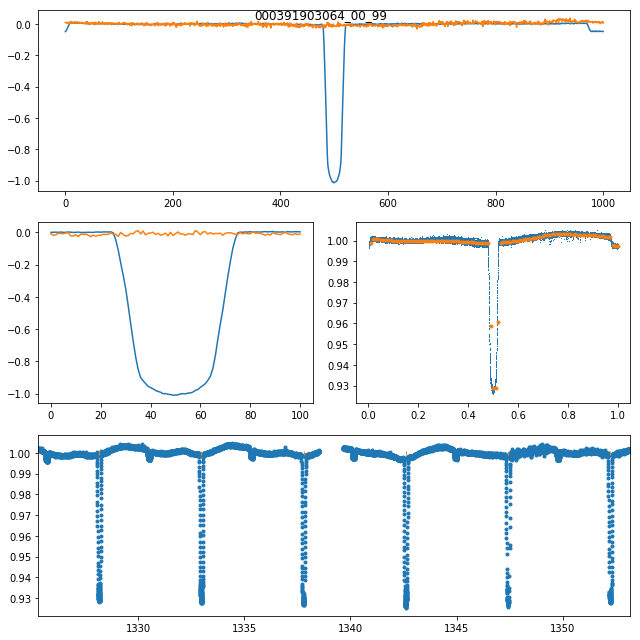

In [94]:
row=rankeddf.loc['000265613590_00_01']
plt.figure(figsize=(9,9))
plt.suptitle(plcand[0])
plt.subplot(311)
#for n,qual in enumerate(['TDEPTH','TDUR','TPERIOD','pl_av_all','rad','Tmag']):
#    plt.text(0,-0.5-0.08*n,qual+": "+"{0:.4g}".format(plcand[1][qual]))
n=0
#plt.text(0,-0.5-0.08*(n+1),"ra: "+str(row['ra']))
#plt.text(0,-0.5-0.08*(n+2),"dec: "+str(row['dec']))
plt.plot(np.load('../Processed_RealDat_2/'+'000265613590_00_01'+'_glob.npy'))
plt.subplot(323)
plt.plot(np.load('../Processed_RealDat_2/'+'000265613590_00_01'+'_loc.npy'))
plt.subplot(313)
lc=[]
for sect in [1,2,3,4]:
    try:
        f=fits.open(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(row['TID'])).zfill(16)))
        lc+=[np.column_stack((f[1].data['TIME'],f[1].data['PDCSAP_FLUX']/np.nanmedian(f[1].data['PDCSAP_FLUX'])))]
    except:
        print(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(row['TID'])).zfill(16)),' - cant access')
lc=np.vstack(lc)
plt.plot(lc[:,0],lc[:,1],'.')
plt.plot(np.arange(row['TEPOCH']-200*row['TPERIOD'],
                 row['TEPOCH']+200.0005*row['TPERIOD'],
                 row['TPERIOD']),np.tile(1.0,401),
         '|',markersize=3.5)
plt.xlim(lc[0,0],lc[-1,0])

plt.subplot(324)
lc[:,0]-=(row['TEPOCH']+row['TPERIOD']*0.5)
lc[:,0]=(lc[:,0]%row['TPERIOD'])/row['TPERIOD']
plt.plot(lc[:,0],lc[:,1],',')
digs=np.digitize(lc[:,0],np.arange(0,1.0,0.01))
flc=[np.nanmedian(lc[digs==bin,1]) for bin in np.arange(101)]
plt.plot(np.arange(0,1.01,0.01),flc,'.')
plt.tight_layout()

In [81]:
toplot.iloc[np.in1d(toplot.TID,np.array([300932479,389669796,177036769,219406747,44737596,177170266]))][['TDEPTH','toi','TDUR','TPERIOD','plrad','pl_av_all','rad','Tmag','ra','dec']]

,TDEPTH,toi,TDUR,TPERIOD,plrad,pl_av_all,rad,Tmag,ra,dec
000300932479_00_04,2120,0.0,2.960066,4.814922,6.420622,0.940487,1.267700,10.633,117.659705,-69.860229
000389669796_00_03,4110,0.0,3.004929,8.481257,6.967171,0.949309,0.987968,10.310,86.899353,-69.366575
000177036769_00_04,1410,0.0,2.562787,4.819050,6.913790,0.780202,1.673840,9.846,102.578024,-66.976430
000219406747_00_03,530,0.0,2.998234,4.171061,9.864749,0.676036,3.895430,7.904,78.810233,-53.093029
000044737596_00_04,26230,0.0,1.950640,2.788476,NaN,0.511224,NaN,13.787,60.949323,-25.408914
000177170266_00_04,5940,0.0,3.192986,4.817378,11.118620,0.617593,1.311490,10.547,104.833505,-69.041051


In [ ]:
from matplotlib import gridspec
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
import matplotlib.patheffects as PathEffects
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300
#,'000098796344_00_04' = IS KOI
toplot=rankeddf.loc[['000300579472_00_01','000141712167_01_99','000319289826_00_01','000300932479_00_04','000389669796_00_03','000177036769_00_04','000219406747_00_03','000044737596_00_04','000177170266_00_04','000207109417_00_03','000391903064_00_99']]
toplot=toplot.sort_values('TSNR')
#fig, axs = plt.subplots(ncols=3, nrows=1)
# generate some data
#x = np.arange(0, 10, 0.2)
#y = np.sin(x)

# plot it
fig = plt.figure(figsize=(6, 8))
gs = gridspec.GridSpec(1, 2, width_ratios=[3, 1]) 
ax0 = plt.subplot(gs[0])
ax1 = plt.subplot(gs[1])
mult=4
txst=[]
for ntid,tid in enumerate(toplot.index.values):
    glob=np.load('../Processed_RealDat_2/'+tid+'_glob.npy')
    ax0.plot(glob[:,0]+mult*ntid,'.',color=sns.color_palette()[ntid])
    txst+=[ax0.text(15,mult*ntid-1.5,'TID'+str(int(tid.split('_')[0])),color='k',fontweight='bold',fontsize=13)]
    loc=np.load('../Processed_RealDat_2/'+tid+'_loc.npy')
    ax1.plot(loc[:,0]+mult*ntid,'.',color=sns.color_palette()[ntid])
    
for txt in txst:
    txt.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='w')])
    plt.draw()
ax0 = plt.subplot(gs[0])
ax0.set_xlim(0,1001)
ax0.set_ylim(-3,mult*ntid+0.95)
ax0.set_xticks([])
ax0.set_yticks([])
ax0.set_xticklabels([])
ax0.set_yticklabels([])
ax1.set_xlim(0,101)
ax1.set_ylim(-3,mult*ntid+0.95)
ax1.set_xticks([])
ax1.set_xticklabels([])
ax1.set_yticks([])
ax1.set_yticklabels([])
plt.tight_layout()
plt.savefig('possible_new_planets.pdf')
plt.savefig('possible_new_planets.png')



In [114]:
'000141712167_01_99' in rankeddf.index

True

In [102]:
os.system('pwd')

0

In [60]:
np.digitize?

In [54]:
plcands.loc[plcand[0]]['allsects_av']

'1'

In [47]:
import os
os.system('mkdir PredictedPlanets')

0

In [41]:
len(rankeddf)

7562

In [42]:
len(tces)

7562

In [58]:
len(np.unique(tois.loc[tois.index=='spoc','TID']))

146

In [57]:
np.sum(np.in1d(np.unique(tois.loc[tois.index=='qlp','TID']),np.unique(tces.TID)))

46

In [ ]:
#191 of the TIDs in the TOI list are in the TCE list
#353 TID are in the TOI list in total..?

## Removing TOI duplications:

In [14]:
dftois=rankeddf.loc[rankeddf['is_toi']>0.0]

In [15]:
dftois.columns[90:]

Index(['TSNR', 'n_det', 'rmsCdpp', 'sector', 'sectors', 'is_toi', 'toi',
       'toi_disp', 'TID', 'ID', 'MH', 'Teff', 'Tmag', 'contratio', 'd', 'dec',
       'gallat', 'gallong', 'logg', 'mass', 'objType', 'pmDEC', 'pmRA', 'ra',
       'rad', 'rho'],
      dtype='object')

In [16]:
len(pd.unique(dftois['toi'].values))

201

In [17]:
dftois_unq=pd.DataFrame()
cols2av=list(dftois.columns[:80])+['pl_av_all', 'pl_med_all']

for itoi in pd.unique(dftois['toi'].values):
    itoidf=dftois.loc[dftois['toi']==itoi]
    if itoidf.shape[0]>1:
        lenss=[len(s) for s in itoidf['sectors'].values]
        if np.sum([ilenss==np.max(lenss) for ilenss in lenss])==1:
            #One TOI has more sectors. Taking that data as it is better.
            dftois_unq=dftois_unq.append(itoidf.iloc[np.argmax(lenss)])
        else:
            itoidf=itoidf.loc[[ilenss==np.max(lenss) for ilenss in lenss]]
            newrow=itoidf.iloc[0]
            newrow[cols2av]=np.average(itoidf[cols2av].values,axis=0)
            newrow['sectors']=' '.join(list(itoidf['sectors'].values))
            dftois_unq=dftois_unq.append(newrow)
    else:
        dftois_unq=dftois_unq.append(itoidf.iloc[0])
    

/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/home/hosborn/.local/lib/python3.5/site-packages/pandas/core/series.py:983: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._set_labels(key, value)
/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [18]:
dftois_unq.loc[(dftois_unq['pl_av_all']>0.5)].shape #(120, 116)

(116, 116)

In [19]:
dftois_unq=dftois_unq.sort_values('pl_av_all',ascending=False)

In [17]:
dftois_unq.shape #(200, 116)

(201, 116)

In [20]:
dftois_unq['TDEPTH']=dftois_unq['TDEPTH'].values.astype(int)
dftois_unq['TID']=dftois_unq['TID'].values.astype(int)
print(dftois_unq.loc[(dftois_unq['pl_av_all']>0.5)*(dftois_unq['is_toi']>0.0)*(dftois_unq['nans']==0.0)][['TID','toi','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].iloc[:32].round(3).to_latex(index=None))

print(np.sum((dftois_unq['pl_av_all']>0.5)*(dftois_unq['is_toi']>0.0)*(dftois_unq['nans']==0.0)))


\begin{tabular}{rrlrrrrrrrrrrrrr}
\toprule
       TID &     toi &  sectors &  TPERIOD &    TEPOCH &   TDUR &  TDEPTH &  binary\_av &  3class\_UNK\_av &  3class\_PL\_av &  3class\_EB\_av &  4class\_UNK\_av &  4class\_PL\_av &  4class\_EB\_av &  4class\_BEB\_av &  pl\_av\_all \\
\midrule
  77031414 &  241.01 &        2 &    1.387 &  1355.196 &  2.290 &   14260 &      0.998 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &            0.0 &      0.999 \\
 122612091 &  264.01 &      3 4 &    2.217 &  1387.831 &  3.846 &    4180 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &            0.0 &      0.999 \\
   1129033 &  398.01 &        4 &    1.360 &  1410.985 &  2.156 &   16380 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &            0.0 &      0.999 \\
 290131778 &  123.01 &        1 &    3.309 &  1325.375 &  5

In [34]:
tois.toi_id

src
qlp     420.01
qlp     421.01
qlp     422.01
qlp     423.01
qlp     424.01
qlp     425.01
qlp     426.01
qlp     427.01
qlp     428.01
qlp     429.01
qlp     430.01
qlp     431.01
qlp     432.01
qlp     433.01
qlp     434.01
qlp     435.01
qlp     436.01
qlp     437.01
qlp     438.01
qlp     439.01
qlp     440.01
qlp     441.01
qlp     442.01
qlp     443.01
qlp     444.01
qlp     445.01
qlp     446.01
qlp     413.01
qlp     447.01
qlp     415.01
         ...  
spoc    118.01
spoc    120.01
spoc    109.01
spoc    121.01
spoc    122.01
spoc    105.01
spoc    123.01
spoc    108.01
spoc    116.01
spoc    126.01
spoc    128.01
spoc    113.01
spoc    130.01
spoc    131.01
spoc    132.01
spoc    133.01
spoc    134.01
spoc    101.01
spoc    135.01
spoc    136.01
spoc    137.01
spoc    104.01
spoc    138.01
spoc    139.01
spoc    107.01
spoc    140.01
spoc    141.01
spoc    103.01
spoc    143.01
spoc    144.01
Name: toi_id, Length: 370, dtype: float64

In [67]:
len(knownpls)

NameError: name 'knownpls' is not defined

In [62]:
dftois_unq['nans']

000350743714_00_03    1.0
000166739520_00_99    0.0
000300871545_02_99    0.0
000183979262_00_99    0.0
000032090583_04_99    1.0
000063898957_01_03    1.0
000009727392_01_02    1.0
000100100827_00_99    0.0
000007624182_01_04    1.0
000051912829_01_99    1.0
000280095254_00_02    1.0
000355509914_00_99    0.0
000382474101_01_02    1.0
000032090583_02_99    1.0
000278683844_03_99    0.0
000070797900_00_02    1.0
000425997655_05_99    1.0
000259962054_00_99    1.0
000309792357_00_02    1.0
000077031414_00_02    0.0
000122612091_00_03    0.0
000001129033_00_04    0.0
000290131778_00_01    0.0
000144065872_00_01    0.0
000038846515_01_99    0.0
000230982885_00_02    0.0
000184240683_00_02    0.0
000267263253_00_01    0.0
000349518800_00_99    0.0
000025375553_00_01    0.0
                     ... 
000029781292_02_99    0.0
000382626661_01_99    0.0
000101948569_00_02    0.0
000055652896_03_99    0.0
000120916706_00_03    0.0
000425934411_00_99    0.0
000141608198_00_99    0.0
000160074939

In [49]:
print(rankeddf.loc[(rankeddf['pl_av_all']>0.25)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])][['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].iloc[:32].round(3).to_latex(index=None))
#Period & Epoch & Dur & Depth 
print(rankeddf.loc[(rankeddf['pl_av_all']>0.75)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])].shape)


\begin{tabular}{rlrrrrrrrrrrrrr}
\toprule
       TID & sectors &  TPERIOD &    TEPOCH &   TDUR &  TDEPTH &  binary\_av &  3class\_UNK\_av &  3class\_PL\_av &  3class\_EB\_av &  4class\_UNK\_av &  4class\_PL\_av &  4class\_EB\_av &  4class\_BEB\_av &  pl\_av\_all \\
\midrule
  92352621 &       1 &    3.950 &  1328.299 &  4.560 &   14230 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.999 \\
 139256217 &       1 &    2.199 &  1325.350 &  3.821 &   18410 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.999 \\
 259470701 &       4 &    2.543 &  1412.514 &  3.845 &   17670 &      0.995 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.998 \\
 231275247 &       2 &    4.008 &  1354.114 &  4.995 &   21100 &      0.995 &          0.000 &         1

In [33]:
109/201

0.5422885572139303

In [314]:
214/353

0.6062322946175638

In [50]:
print(rankeddf.loc[(rankeddf['is_toi']>0.0)*(rankeddf['3class_EB_av']>0.4)*((rankeddf['4class_EB_av']>0.4)|(rankeddf['4class_BEB_av']>0.4))*(~rankeddf['nans'])][['TID','toi','3class_UNK_av','3class_PL_av','3class_EB_av','4class_EB_av','4class_BEB_av']][::-1].round(2).to_latex(index=False))


\begin{tabular}{rrrrrrr}
\toprule
       TID &     toi &  3class\_UNK\_av &  3class\_PL\_av &  3class\_EB\_av &  4class\_EB\_av &  4class\_BEB\_av \\
\midrule
   2760710 &  227.01 &           0.09 &          0.00 &          0.91 &          0.84 &           0.02 \\
 272086159 &  176.01 &           0.00 &          0.00 &          1.00 &          0.88 &           0.00 \\
 272086159 &  176.01 &           0.00 &          0.00 &          1.00 &          0.80 &           0.00 \\
 425934411 &  142.01 &           0.51 &          0.00 &          0.49 &          0.00 &           0.68 \\
 279740441 &  273.01 &           0.57 &          0.00 &          0.43 &          0.00 &           0.84 \\
 272086159 &    0.00 &           0.00 &          0.00 &          1.00 &          0.30 &           0.69 \\
  92226327 &  256.01 &           0.15 &          0.00 &          0.85 &          0.56 &           0.28 \\
 425934411 &  142.01 &           0.16 &          0.01 &          0.84 &          0.00 &           0

# PLOTTING LIKELY EBS

/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/home/hosborn/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1019: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/hosborn/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice e

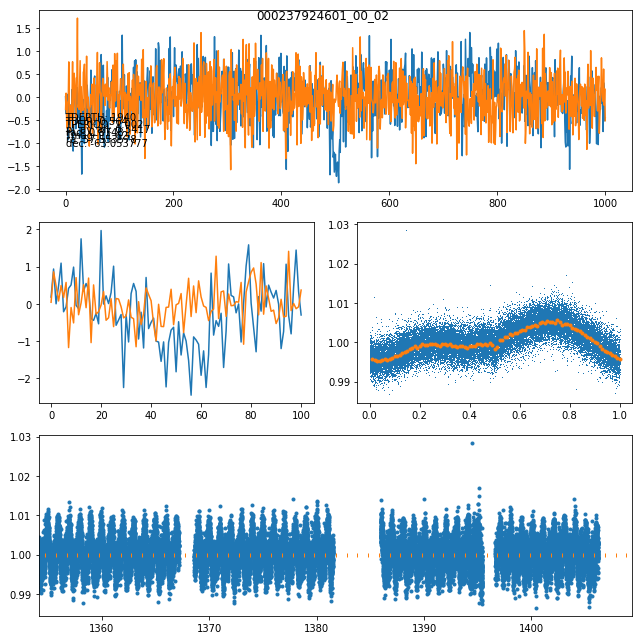

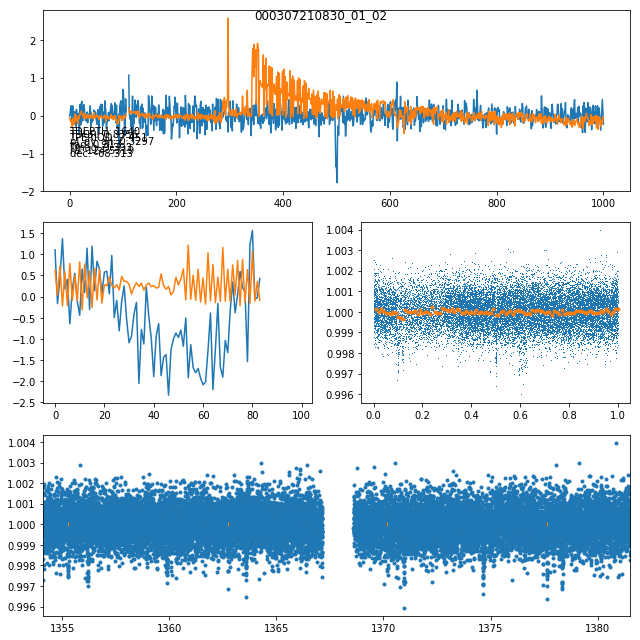

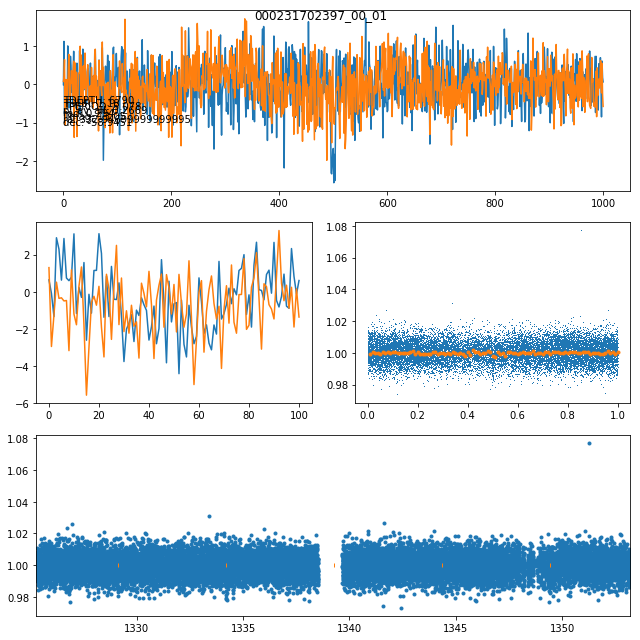

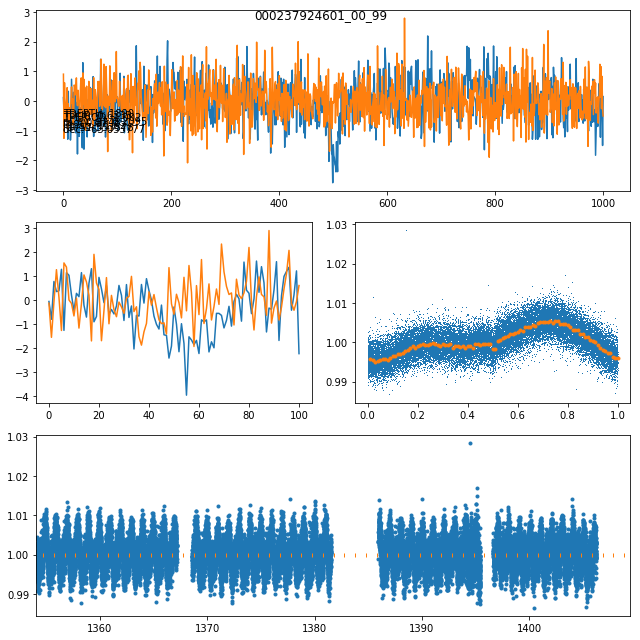

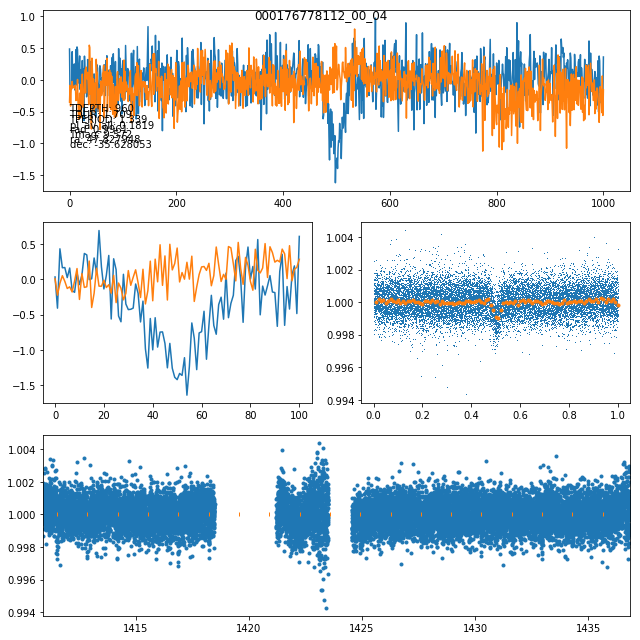

...

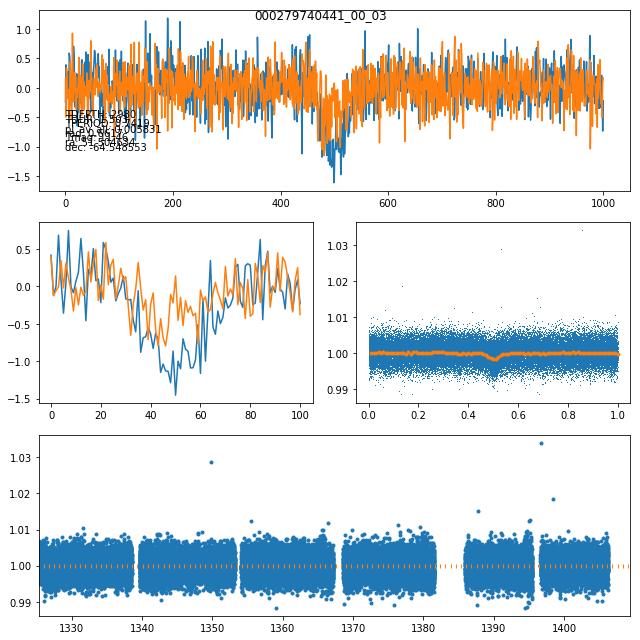

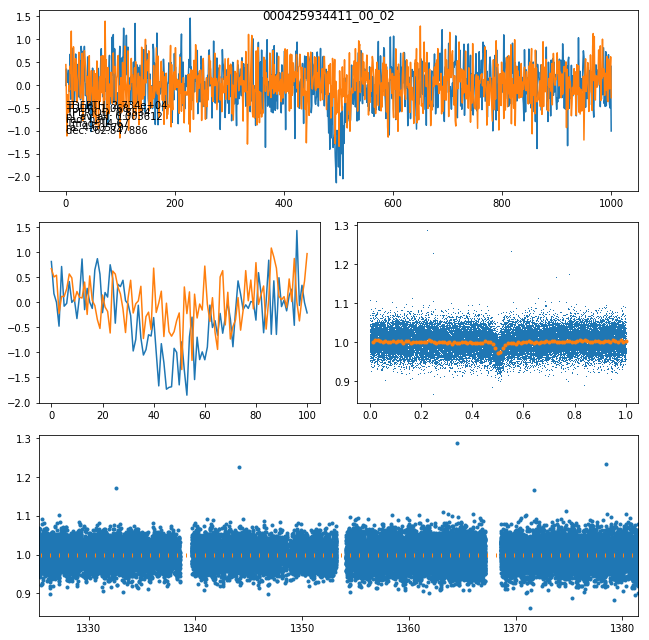

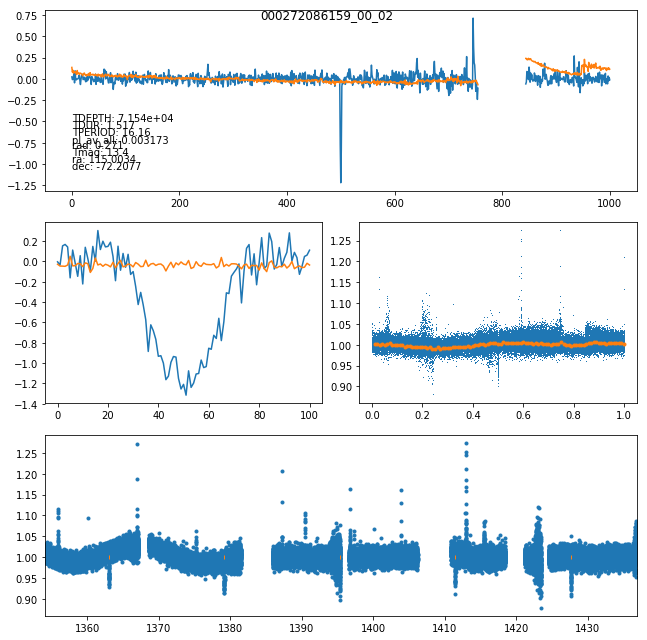

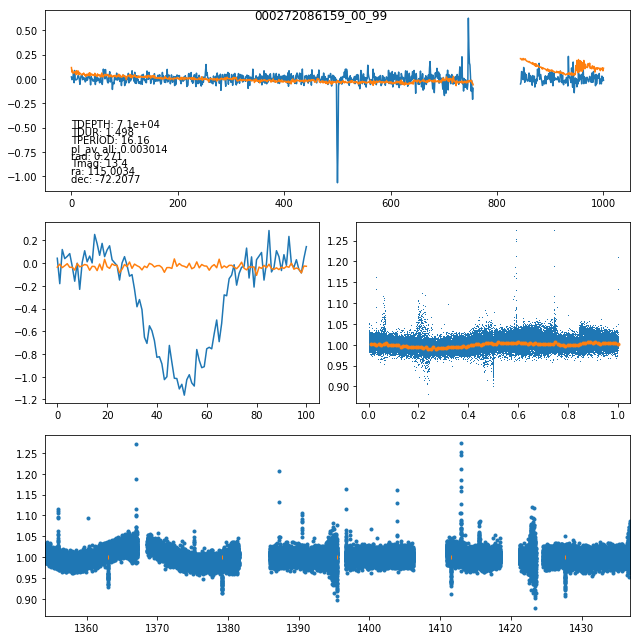

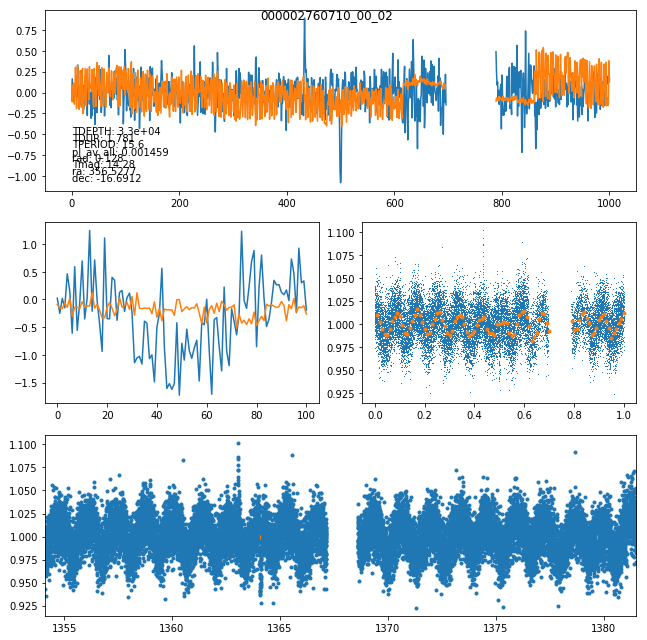

In [67]:
import os
import requests
import astropy.io.fits as fits

LC_locs={1:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018206045859-s0001-TIDTIDTIDTID-0120-s_lc.fits",
         2:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018234235059-s0002-TIDTIDTIDTID-0121-s_lc.fits",
         3:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018263035959-s0003-TIDTIDTIDTID-0123-s_lc.fits",
         4:"https://mast.stsci.edu/api/v0.1/Download/file/?uri=mast:TESS/product/tess2018292075959-s0004-TIDTIDTIDTID-0124-s_lc.fits"}

os.system('mkdir PredictedEBs')

likEBs=rankeddf.loc[(rankeddf['is_toi']>0.0)*(rankeddf['3class_EB_av']>0.4)*((rankeddf['4class_EB_av']>0.4)|(rankeddf['4class_BEB_av']>0.4))*(~rankeddf['nans'])]
likEBs['allsects_av']=np.tile('',len(likEBs))
likEBs['allsects_intce']=np.tile('',len(likEBs))

for row in likEBs.iterrows():
    for sect in LC_locs:
        request = requests.get(LC_locs[sect].replace('TIDTIDTIDTID',str(int(row[1]['TID'])).zfill(16)))
        if request.status_code == 200:
            likEBs.loc[row[0],'allsects_av']+=str(sect)
        allsects=' '.join(list(tces.loc[(tces.TID==row[1]['TID'])]['sectors'].values))
        if str(sect) in allsects:
            likEBs.loc[row[0],'allsects_intce']+=str(sect)
        #*(sect in tces.TID==row[1]['TID'])]



for ebrow in likEBs.iterrows():
    plt.figure(figsize=(9,9))
    plt.suptitle(ebrow[0])
    plt.subplot(311)
    for n,qual in enumerate(['TDEPTH','TDUR','TPERIOD','pl_av_all','rad','Tmag']):
        plt.text(0,-0.5-0.08*n,qual+": "+"{0:.4g}".format(ebrow[1][qual]))
    plt.text(0,-0.5-0.08*(n+1),"ra: "+str(ebrow[1]['ra']))
    plt.text(0,-0.5-0.08*(n+2),"dec: "+str(ebrow[1]['dec']))
    plt.plot(np.load('../Processed_RealDat_2/'+ebrow[0]+'_glob.npy'))
    plt.subplot(323)
    plt.plot(np.load('../Processed_RealDat_2/'+ebrow[0]+'_loc.npy'))
    plt.subplot(313)
    lc=[]
    for sect in ebrow[1]['allsects_av']:
        try:
            f=fits.open(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(ebrow[1]['TID'])).zfill(16)))
            lc+=[np.column_stack((f[1].data['TIME'],f[1].data['PDCSAP_FLUX']/np.nanmedian(f[1].data['PDCSAP_FLUX'])))]
        except:
            print(LC_locs[int(sect)].replace('TIDTIDTIDTID',str(int(ebrow[1]['TID'])).zfill(16)),' - cant access')
    lc=np.vstack(lc)
    plt.plot(lc[:,0],lc[:,1],'.')
    plt.plot(np.arange(ebrow[1]['TEPOCH']-200*ebrow[1]['TPERIOD'],
                     ebrow[1]['TEPOCH']+200.0005*ebrow[1]['TPERIOD'],
                     ebrow[1]['TPERIOD']),np.tile(1.0,401),
             '|',markersize=3.5)
    plt.xlim(lc[0,0],lc[-1,0])
    
    plt.subplot(324)
    lc[:,0]-=(ebrow[1]['TEPOCH']+ebrow[1]['TPERIOD']*0.5)
    lc[:,0]=(lc[:,0]%ebrow[1]['TPERIOD'])/ebrow[1]['TPERIOD']
    plt.plot(lc[:,0],lc[:,1],',')
    digs=np.digitize(lc[:,0],np.arange(0,1.0,0.01))
    flc=[np.nanmedian(lc[digs==bin,1]) for bin in np.arange(101)]
    plt.plot(np.arange(0,1.01,0.01),flc,'.')
    
    plt.tight_layout()
    plt.savefig("PredictedEBs/"+ebrow[0]+'.png')


In [68]:
len(tesspls)

16

In [21]:
knownbefore='398.01,259.01,114.01,109.01,400.01,106.01,228.01,113.01,185.01,264.01,105.01,102.01,415.01,246.01,265.01,247.01,190.01,404.01,267.01,413.01,418.01,191.01,192.01,250.01,255.01,231.01,194.01,195.01,101.01,104.01,116.01,403.01,272.01,110.01,115.01,108.01,117.01,103.01,111.01,391.01,112.01,232.01,388.01'.split(',')
tesspls=np.array('256.01,256.02,144.01,123.01,136.01,216.01,216.02,125.01,125.02,125.03,186.01,186.02,174.01,197.01,120.01,135.01'.split(',')).astype(float)



In [22]:
dftois_unq.iloc[np.in1d(dftois_unq.toi.values,np.array(tesspls).astype(float))][['TID','toi','sectors','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']].round(3).to_latex(index=False)


'\\begin{tabular}{rrlrrrrrrrrr}\n\\toprule\n       TID &     toi & sectors &  binary\\_av &  3class\\_UNK\\_av &  3class\\_PL\\_av &  3class\\_EB\\_av &  4class\\_UNK\\_av &  4class\\_PL\\_av &  4class\\_EB\\_av &  4class\\_BEB\\_av &  pl\\_av\\_all \\\\\n\\midrule\n 290131778 &  123.01 &       1 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.999 \\\\\n 267263253 &  135.01 &       1 &      0.997 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.999 \\\\\n 394137592 &  120.01 &       1 &      0.915 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.972 \\\\\n  52368076 &  125.01 &     1 2 &      0.889 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      0.963 \\\\\n  52368076 &  125.02 

In [23]:
dftois_unq.iloc[np.in1d(dftois_unq.toi.values,np.array(tesspls).astype(float))][['TID','toi','sectors','binary_av','3class_UNK_av','3class_PL_av','3class_EB_av','4class_UNK_av','4class_PL_av','4class_EB_av','4class_BEB_av','pl_av_all']]

,TID,toi,sectors,binary_av,3class_UNK_av,3class_PL_av,3class_EB_av,4class_UNK_av,4class_PL_av,4class_EB_av,4class_BEB_av,pl_av_all
000290131778_00_01,290131778,123.01,1,0.997160,1.429574e-10,1.000000,4.771444e-17,2.892620e-12,1.000000e+00,1.291561e-13,6.464250e-12,0.999053
000267263253_00_01,267263253,135.01,1,0.996677,3.217572e-09,1.000000,3.701621e-21,1.628723e-12,1.000000e+00,9.284554e-15,1.209359e-15,0.998892
000394137592_00_01,394137592,120.01,1,0.914786,7.635830e-05,0.999924,9.088433e-16,2.353246e-07,9.999998e-01,2.001151e-12,6.605385e-09,0.971570
000052368076_00_99,52368076,125.01,1 2,0.889473,4.252140e-04,0.999575,3.493188e-09,4.910805e-07,9.999995e-01,1.341693e-14,2.050023e-10,0.963016
000052368076_01_99,52368076,125.02,1 2,0.821460,1.442503e-03,0.998558,4.163016e-09,1.155268e-05,9.999883e-01,3.149898e-13,8.891150e-08,0.940002
000425997655_02_99,425997655,174.01,1 2 3,0.536027,7.243430e-02,0.927504,6.123560e-05,9.360546e-06,9.996252e-01,1.313693e-05,3.522784e-04,0.821052
000055652896_02_99,55652896,216.01,1 2 3,0.256680,1.390118e-02,0.806315,1.797836e-01,1.040206e-01,7.684599e-01,1.251389e-01,2.380657e-03,0.610485
000261136679_00_01,261136679,144.01,1,0.394580,5.985635e-01,0.401436,1.434193e-07,5.347100e-01,4.636941e-01,8.739856e-13,1.595902e-03,0.419903
000410153553_00_01,410153553,136.01,1,0.315228,2.579026e-01,0.491910,2.501875e-01,6.430656e-01,2.499551e-01,2.363564e-03,1.046157e-01,0.352364
000441462736_00_02,441462736,197.01,2,0.344588,4.273716e-01,0.572624,3.944498e-06,8.447559e-01,3.035350e-02,7.710037e-09,1.248906e-01,0.315855


In [53]:
dftois_unq.iloc[np.in1d(dftois_unq.toi.values,np.array(tesspls).astype(float))].shape

(14, 116)

In [54]:
dftois_unq.iloc[np.in1d(dftois_unq.toi.values,np.array(knownbefore).astype(float))].shape

(42, 116)

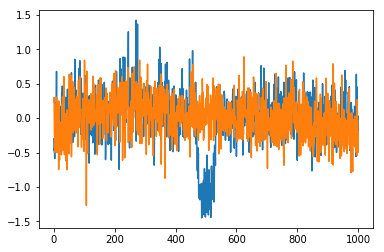

In [365]:
(42-2)/42

0.9523809523809523

In [359]:
(42-9)/42

0.7857142857142857

In [ ]:
199.01,174.04,218.01,412.01,185.01,235.01,180.01,224.01,203.01

In [363]:
'190.01' in knownbefore

True

In [354]:
len(knownbefore)

43

In [246]:
#388.01 = WASP-71 = EB
#136.01 = LHS3844 = UNK
#232.01 = WASP-4 = UNK
#112.01 = WASP-119 = EB/UNK
#391.01 = WASP-50 = UNK
#111.01 = HATS-34 = UNK
#103.01 = HATS-3  = UNK
#117.01 = HATS-69 = 
#398.01 = WASP-77 = UNK

rankeddf.loc[rankeddf.toi==398.01].iloc[0]

binary_med        5.24052e-05
binary_av         0.000255436
nans                    False
3class_unk_med              1
3class_unk_av               1
3class_pl_med      1.6315e-16
3class_pl_av       1.6315e-16
3class_eb_med     1.09713e-14
3class_eb_av      1.09713e-14
4class_unk_med              1
4class_unk_av               1
4class_pl_med     3.19408e-16
4class_pl_av      3.19408e-16
4class_eb_med     4.71335e-26
4class_eb_av      4.71335e-26
pl_av_all         3.19408e-16
pl_med_all        1.74684e-05
rank                      267
4class_beb_med    1.86111e-29
4class_beb_av     1.86111e-29
MAXMES                348.148
MAXSES                108.717
TDEPTH                  16380
TDUR                  2.15633
TEPOCH                1410.98
TPERIOD               1.36003
TSNR                  384.991
n_det                       0
rmsCdpp                   NaN
sector                      4
sectors                     4
is_toi                    0.5
toi                    398.01
toi_disp  

In [77]:
tab['binary_med']=mod2['real']['med']
tab['binary_av']=mod2['real']['av']
tab=tab.set_index(np.load('real_idlist4.npy'))
tab['nans']=False

labels=['unk','pl','eb','beb']
for n in range(3):
    tab['3class_'+labels[n]+'_med']=mod3['real']['med'][:,n]
    tab['3class_'+labels[n]+'_av']=mod3['real']['av'][:,n]
for n in range(4):
    tab['4class_'+labels[n]+'_med']=mod4['real']['med'][:,n]
    tab['4class_'+labels[n]+'_av']=mod4['real']['av'][:,n]
tab['pl_av_all']=np.nanmedian(np.column_stack((mod2['real']['med'],mod3['real']['med'][:,1],mod4['real']['med'][:,1])),axis=1)
tab['pl_med_all']=np.average(np.column_stack((mod2['real']['med'],mod3['real']['med'][:,1],mod4['real']['med'][:,1])),axis=1)

tab2['binary_med']=mod2['real_nan']['med']
tab2['binary_av']=mod2['real_nan']['av']
tab2=tab2.set_index(np.load('real_nan_idlist4.npy'))
tab2['nans']=True
labels=['unk','pl','eb','beb']
for n in range(3):
    tab2['3class_'+labels[n]+'_med']=mod3['real_nan']['med'][:,n]
    tab2['3class_'+labels[n]+'_av']=mod3['real_nan']['av'][:,n]
for n in range(4):
    tab2['4class_'+labels[n]+'_med']=mod4['real_nan']['med'][:,n]
    tab2['4class_'+labels[n]+'_av']=mod4['real_nan']['av'][:,n]
tab2['pl_av_all']=np.nanmedian(np.column_stack((mod2['real_nan']['med'],mod3['real_nan']['med'][:,1],mod4['real_nan']['med'][:,1])),axis=1)
tab2['pl_med_all']=np.average(np.column_stack((mod2['real_nan']['med'],mod3['real_nan']['med'][:,1],mod4['real_nan']['med'][:,1])),axis=1)
tab2['rank']=np.argsort(tab2['pl_av_all'])+len(tab)


KeyError: "['3class_unk_av' '3class_pl_av' '3class_eb_av' '4class_unk_av'\n '4class_pl_av' '4class_eb_av' '4class_beb_av'] not in index"

In [224]:
print(rankeddf.loc[(rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans'])][['TID','sectors','TPERIOD','TEPOCH','TDUR','TDEPTH','binary_av','3class_unk_av','3class_pl_av','3class_eb_av','4class_unk_av','4class_pl_av','4class_eb_av','4class_beb_av','pl_av_all']].round(3).to_latex(index=None))
#Period & Epoch & Dur & Depth 

\begin{tabular}{rlrrrrrrrrrrrrr}
\toprule
       TID & sectors &  TPERIOD &    TEPOCH &     TDUR &  TDEPTH &  binary\_av &  3class\_unk\_av &  3class\_pl\_av &  3class\_eb\_av &  4class\_unk\_av &  4class\_pl\_av &  4class\_eb\_av &  4class\_beb\_av &  pl\_av\_all \\
\midrule
 229153733 &       3 &    0.502 &  1386.387 &    1.362 &     340 &      1.000 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      1.000 \\
  92254719 &       1 &    0.705 &  1325.724 &    7.446 &   34860 &      1.000 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      1.000 \\
 434096244 &       2 &   19.228 &  1359.938 &    3.623 &    5590 &      0.999 &          0.000 &         1.000 &         0.000 &          0.000 &         1.000 &         0.000 &          0.000 &      1.000 \\
 150392584 &   1 2 3 &   30.017 &  1348.522 &    2.377 &    4790 &      0.999 &          0.000 &

/home/hosborn/.local/lib/python3.5/site-packages/pandas/core/computation/expressions.py:180: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


In [149]:
rankeddf.columns

Index(['binary_med', 'binary_av', 'nans', '3class_unk_med', '3class_unk_av',
       '3class_pl_med', '3class_pl_av', '3class_eb_med', '3class_eb_av',
       '4class_unk_med', '4class_unk_av', '4class_pl_med', '4class_pl_av',
       '4class_eb_med', '4class_eb_av', 'pl_av_all', 'pl_med_all', 'rank',
       '4class_beb_med', '4class_beb_av', 'MAXMES', 'MAXSES', 'TDEPTH', 'TDUR',
       'TEPOCH', 'TPERIOD', 'TSNR', 'n_det', 'rmsCdpp', 'sector', 'sectors',
       'is_toi', 'toi', 'toi_disp', 'TID', 'ID', 'MH', 'Teff', 'Tmag',
       'contratio', 'd', 'dec', 'gallat', 'gallong', 'logg', 'mass', 'objType',
       'pmDEC', 'pmRA', 'ra', 'rad', 'rho'],
      dtype='object')

/home/hosborn/.local/lib/python3.5/site-packages/pandas/core/computation/expressions.py:180: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


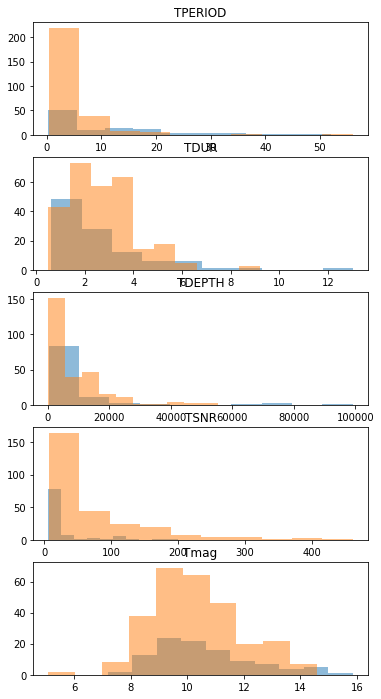

In [298]:
plt.figure(figsize=(6,12))
labs=['TPERIOD','TDUR','TDEPTH','TSNR','Tmag']
for i in range(5):
    plt.subplot(5,1,i+1)
    plt.title(labs[i])
    plt.hist(rankeddf.loc[(rankeddf['pl_av_all']<0.1)*(rankeddf['is_toi']>0.0)][labs[i]],alpha=0.5)
    plt.hist(rankeddf.loc[(rankeddf['pl_av_all']>0.1)*(rankeddf['is_toi']>0.0)][labs[i]],alpha=0.5)


In [161]:
len(pd.unique(rankeddf.TID))

3266

In [299]:
np.sum((rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']==0.0)*(~rankeddf['nans']))

214

In [300]:
np.sum((rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']>0.0)*(~rankeddf['nans']))

221

In [303]:
np.sum((rankeddf['pl_av_all']>0.5)*(rankeddf['is_toi']>0.0)*(~rankeddf['nans']))

10

In [140]:
pd.unique(rankeddf.sectors)

array(['1', '2', '1 2 3', '3', '4', '1 2'], dtype=object)

In [125]:
np.sum((rankeddf['is_toi']>0.0)*(~rankeddf['nans']))

353

binary_med           0.912821
binary_av            0.889117
nans                    False
3class_unk_med        0.99999
3class_unk_av         0.99999
3class_pl_med     1.04224e-05
3class_pl_av      1.04224e-05
3class_eb_med      1.5691e-19
3class_eb_av       1.5691e-19
4class_unk_med    2.84807e-08
4class_unk_av     2.84807e-08
4class_pl_med               1
4class_pl_av                1
4class_eb_med     2.69103e-27
4class_eb_av      2.69103e-27
pl_av_all            0.912821
pl_med_all            0.63761
rank                     4343
4class_beb_med    1.13728e-38
4class_beb_av     1.13728e-38
MAXMES                12.3134
MAXSES                6.43091
TDEPTH                4415.46
TDUR                  1.87026
TEPOCH                1329.82
TPERIOD               9.01014
TSNR                  12.5617
n_det                       1
rmsCdpp                   NaN
sector                     99
sectors               [[1 2]]
is_toi                      1
toi                    210.01
toi_disp  

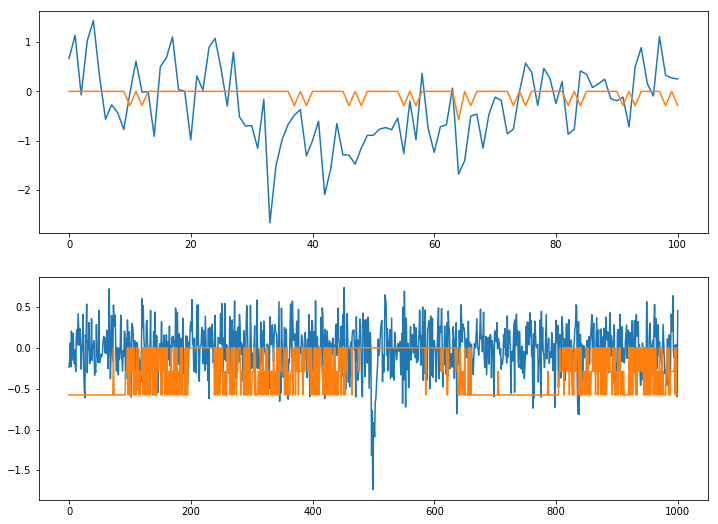

In [124]:
tid='000141608198_01_99'
plt.figure(figsize=(12,9))
plt.subplot(211)
plt.plot(np.load('../Processed_RealDat_2/'+tid+'_loc.npy'))
plt.subplot(212)
plt.plot(np.load('../Processed_RealDat_2/'+tid+'_glob.npy'))
df.loc[tid]

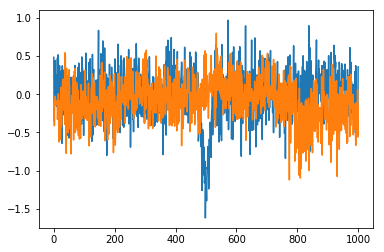

In [202]:
avpls=np.average(np.column_stack((mod2['test']['av'],mod3['test']['av'][:,1],mod4['test']['av'][:,1])),axis=1)
medpls=np.median(np.column_stack((mod2['test']['med'],mod3['test']['med'][:,1],mod4['test']['med'][:,1])),axis=1)

In [167]:
gt=np.load('model_gt.npy')

In [199]:
len(gt)==len(avpls)

True

In [203]:
thresh=0.5
print("AP:",average_precision_score((gt==1).astype(int),avpls,average=None))
print("recall:",np.sum((avpls>thresh)*(gt==1))/np.sum(gt==1))
print("accuracy:",np.sum((avpls>thresh)*(gt==1))/np.sum(avpls>thresh))


AP: 0.955665447033597
recall: 0.8909090909090909
accuracy: 0.9050131926121372


In [204]:
thresh=0.5
print("AP:",average_precision_score((gt==1).astype(int),medpls))
print("recall:",np.sum((medpls>thresh)*(gt==1))/np.sum(gt==1))
print("accuracy:",np.sum((medpls>thresh)*(gt==1))/np.sum(medpls>thresh))


AP: 0.9403007194276747
recall: 0.8987012987012987
accuracy: 0.9153439153439153


In [223]:
thresh=0.9
print("AP:",average_precision_score((gt==1).astype(int),mod2['test']['av']))
print("recall:",np.sum((mod2['test']['av']>thresh)*(gt==1))/np.sum(gt==1))
print("accuracy:",np.sum((mod2['test']['av']>thresh)*(gt==1))/np.sum(mod2['test']['av']>thresh))


AP: 0.9557892461233882
recall: 0.7142857142857143
accuracy: 0.975177304964539


In [220]:
thresh=0.5
print("AP:",average_precision_score((gt==1).astype(int),mod3['test']['av'][:,1]))
print("recall:",np.sum((mod3['test']['av'][:,1]>thresh)*(gt==1))/np.sum(gt==1))
print("accuracy:",np.sum((mod3['test']['av'][:,1]>thresh)*(gt==1))/np.sum(mod3['test']['av'][:,1]>thresh))


AP: 0.928674080642794
recall: 0.8519480519480519
accuracy: 0.9213483146067416


In [208]:
thresh=0.5
print("AP:",average_precision_score((gt==1).astype(int),mod4['test']['av'][:,1]))
print("recall:",np.sum((mod4['test']['av'][:,1]>thresh)*(gt==1))/np.sum(gt==1))
print("accuracy:",np.sum((mod4['test']['av'][:,1]>thresh)*(gt==1))/np.sum(mod4['test']['av'][:,1]>thresh))


AP: 0.9003204398377764
recall: 0.9012987012987013
accuracy: 0.8631840796019901


array([9.99998152e-01, 3.81871623e-12, 5.17540593e-06, ...,
       5.06599747e-04, 1.72061027e-05, 4.38136776e-05])

In [70]:
tois = pd.DataFrame.from_csv('/mnt/disks/tessdata/RealData/TOIs.csv')#,index_col=None)

/home/hosborn/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: FutureWarning: from_csv is deprecated. Please use read_csv(...) instead. Note that some of the default arguments are different, so please refer to the documentation for from_csv when changing your function calls
  """Entry point for launching an IPython kernel.


In [71]:
tois.columns

Index(['tic_id', 'toi_id', 'Disposition', 'RA', 'Dec', 'Tmag', 'Tmag Err',
       'Epoc', 'Epoc Err', 'Period', 'Period Err', 'Duration', 'Duration Err',
       'Transit Depth', 'Transit Depth Err', 'Sectors', 'Created', 'Updated'],
      dtype='object')

In [72]:
214517426 in tois.tic_id

False

In [23]:
#binary, 0= not planet. 1=planet
np.argsort(mod2['real']['med'])

array([ 529, 3530, 3538, ..., 4163, 2729, 1615])

In [24]:
#3-class, 0 on 2nd col = not planet. 1=planet
np.argsort(mod3['real']['med'][:,1])

array([ 700, 2245, 4701, ..., 3590,  416, 3170])

In [25]:
np.argsort(mod4['real']['med'][:,1])

array([4224, 1727, 4179, ...,  586, 2468, 3713])

In [ ]:
ids

In [ ]:
tces.join()

In [601]:
mod2['test'].rename(columns={c:'2_PL_'+c for c in mod2['test'].columns})

TypeError: 'set' object is not callable

In [20]:
tests=pd.concat([mod2['test'].rename(columns={c:'2_PL_'+c for c in mod2['test'].columns}),
                mod3['test'].rename(columns={c:'3_'+c for c in mod3['test'].columns}),
                mod4['test'].rename(columns={c:'4_'+c for c in mod4['test'].columns})],axis=1)

In [21]:
labs={3:['UNK','EB'],
      4:['UNK','EB','BEB']}
testpls=[]
testothers=[]
others_ind={}
pls_ind={}
for nmod in range(2,5):
    for nk in range(8):
        testpls+=[tests[[str(nmod)+'_PL_'+str(nk)]].values]
        if nmod==2:
            testothers+=[1.0-tests[[str(nmod)+'_PL_'+str(nk)]].values]
            #binary
        else:
            testothers+=[np.sum(tests[[str(nmod)+'_'+lab+'_'+str(nk) for lab in labs[nmod]]].values,axis=1)]
    others_ind[nmod]=np.column_stack((testothers[-8:]))
    pls_ind[nmod]=np.column_stack((testpls[-8:]))

In [22]:
other_pred_med=np.nanmedian(np.column_stack((testothers)),axis=1)
pl_pred_med=np.nanmedian(np.column_stack((testpls)),axis=1)
other_pred_av=np.average(np.column_stack((testothers)),axis=1)
pl_pred_av=np.average(np.column_stack((testpls)),axis=1)

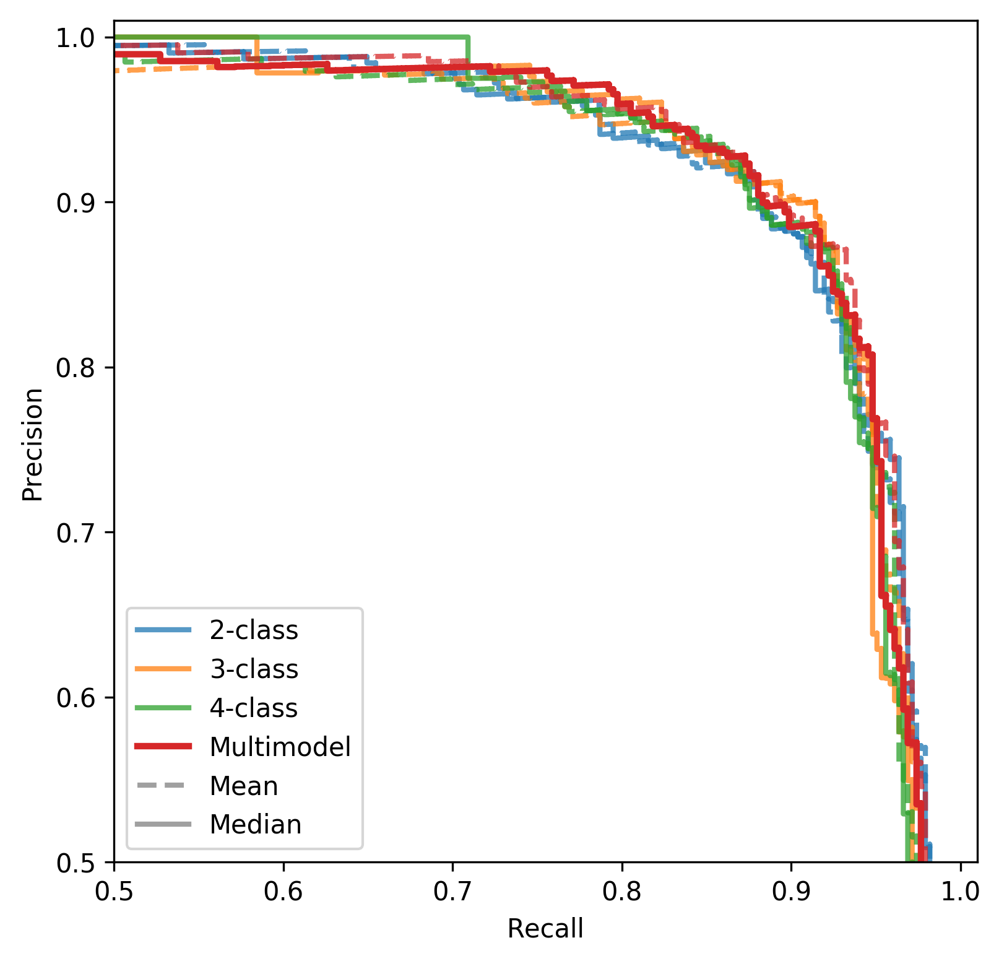

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300

plt.figure(figsize=(6,6))

labels=['UNK','PL','EB','BEB']
#one_hot_gt=make_one_hot(model_output['test']['gt'].values,nclasses)
### plot values
for l in [2,3,4]:
    if l==2:
        gt=tests['2_PL_gt']
    elif l==3:
        gt=(tests['3_gt']==1.0).astype(int)
    else:
        gt=(tests['4_gt']==1.0).astype(int)
    P, R, _ =precision_recall_curve(gt,np.nanmedian(pls_ind[l],axis=1))
    steps=plt.step(R, P,label=str(l)+'-class',linewidth=2.0,alpha=0.75)
    P, R, _ =precision_recall_curve(gt,np.average(pls_ind[l],axis=1))
    plt.step(R, P,linewidth=2.0,alpha=0.75,linestyle='--',color=steps[0].get_color())
    
P, R, _ =precision_recall_curve(tests['2_PL_gt'],pl_pred_med)
steps=plt.step(R, P,label='Multimodel',linewidth=2.5)
P, R, _ =precision_recall_curve(tests['2_PL_gt'],pl_pred_av)
plt.step(R, P,linewidth=2.0,alpha=0.75,linestyle='--',color=steps[0].get_color())

plt.step([0,0],[0,0],c='gray',linestyle='--',linewidth=2.0,alpha=0.75,label='Mean')
plt.step([0,0],[0,0],c='gray',linestyle='-',linewidth=2.0,alpha=0.75,label='Median')
plt.legend()

plt.xlim(0.5,1.01)
plt.ylim(0.5,1.01)

plt.xlabel('Recall')
plt.ylabel('Precision')
savefile='Ensemble_all_compare_planets_testdat'
plt.savefig(path.join('/home/hosborn/TESS/PaperFigures',savefile+'_PR_2.png'))
plt.savefig(path.join('/home/hosborn/TESS/PaperFigures',savefile+'_PR_2.pdf'))

In [26]:
print(average_precision_score(tests['2_PL_gt'],pl_pred_av))
print(average_precision_score(tests['2_PL_gt'],np.average(pls_ind[4],axis=1)))
print(average_precision_score(tests['2_PL_gt'],np.average(pls_ind[3],axis=1)))
print(average_precision_score(tests['2_PL_gt'],np.average(pls_ind[2],axis=1)))

0.9556501781932241
0.9448649150724617
0.9457146336827876
0.9519712170371073


'#1f77b4'

000358070970_00_02    1.0
000248988932_00_04    0.0
000269594275_00_04    0.0
000220476100_00_01    0.0
000260356202_01_99    0.0
000372908550_16_03    0.0
000266716027_00_04    0.0
000279726530_06_99    0.0
000237339895_00_02    0.0
000234520087_01_99    0.0
000183985164_01_03    0.0
000266966948_00_01    0.0
000360736543_00_01    1.0
000183495016_03_99    0.0
000349192028_05_01    0.0
000123292130_00_04    1.0
000267114952_02_03    0.0
000150358991_03_02    1.0
000260078169_06_99    1.0
000033835925_00_01    0.0
000261542169_01_99    0.0
000031942864_00_01    0.0
000259863095_00_01    0.0
000220526640_02_02    0.0
000220432563_00_99    0.0
000425938854_04_03    0.0
000050381881_08_02    0.0
000144000467_00_02    1.0
000277147381_02_01    0.0
000294784092_00_99    0.0
                     ... 
000401839949_02_04    0.0
000010803257_00_04    0.0
000219984873_02_03    1.0
000220436792_00_01    0.0
000421940749_00_02    0.0
000373523595_04_03    0.0
000346704136_00_01    1.0
000167087044

In [ ]:
tab=
mod2['test']
mod3['test']
mod4['test']

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300

plt.figure(figsize=(6,6))

labels=['UNK','PL','EB','BEB']
one_hot_gt=make_one_hot(model_output['test']['gt'].values,nclasses)
### plot values
for n in range(nclasses):
    P, R, _ =precision_recall_curve(one_hot_gt[:,n],medvals[:,n])
    plt.step(R, P,label=labels[n]+'_Med',linewidth=2.5)
    P, R, _ =precision_recall_curve(one_hot_gt[:,n],avvals[:,n])
    plt.step(R, P,label=labels[n]+'_Av',linewidth=2.5)
plt.legend()

plt.xlabel('Recall')
plt.ylabel('Precision')
savefile='4class_ensemble_testdat_avmedcomp.png'
plt.savefig(path.join('/home/hosborn/TESS/PaperFigures',savefile+'_PR.png'))
plt.savefig(path.join('/home/hosborn/TESS/PaperFigures',savefile+'_PR.pdf'))